# Batch Normalization

![Status](https://img.shields.io/static/v1.svg?label=Status&message=Finished&color=brightgreen)
[![Source](https://img.shields.io/static/v1.svg?label=GitHub&message=Source&color=181717&logo=GitHub)](https://github.com/particle1331/ok-transformer/blob/master/docs/nb/nn/03-batchnorm.ipynb)
[![Stars](https://img.shields.io/github/stars/particle1331/ok-transformer?style=social)](https://github.com/particle1331/ok-transformer)

---

## Introduction

Training neural networks involves computation across millions of weights and activations. From blowing up countless loss functions, we know that [training can be fragile](https://lossfunctions.tumblr.com/). In this notebook, we will dive into the internals of MLPs with multiple layers and scrutinize the statistics of activations, weights and gradients, and some of the pitfalls when they are improperly scaled. We will look at typical diagnostic tools and visualizations to use to understand the health of a deep network during training. Finally, we introduce the first modern innovation that made training deep networks so much easier: **Batch normalization** {cite}`batchnorm`.

## Preliminaries

In [1]:
import torch
import torch.nn.functional as F

import math
import warnings
import numpy as np
import matplotlib.pyplot as plt

from pathlib import Path
from tqdm.auto import tqdm
from matplotlib_inline import backend_inline

DATASET_DIR = Path("./data").absolute()
RANDOM_SEED = 1
torch.manual_seed(RANDOM_SEED)

warnings.simplefilter(action="ignore")
backend_inline.set_matplotlib_formats('svg')

### Dataset

Still using the names dataset:

In [2]:
names = open(DATASET_DIR / 'names.txt', 'r').read().splitlines()

print(len(names))
names[:5]

32033


['emma', 'olivia', 'ava', 'isabella', 'sophia']

In [3]:
class CharDataset:
    def __init__(self, names, block_size):
        self.names = names
        self.vocab = ['.'] + sorted(list(set(''.join(names))))
        self.block_size = block_size
        self.itos = dict(enumerate(self.vocab))
        self.stoi = {c: i for i, c in self.itos.items()}

    def decode(self, x):
        return ''.join(self.itos[i] for i in x)

    def encode(self, word):
        return [self.stoi[c] for c in word]

    def build_dataset(self):
        """Creating subsequences -> next character target."""
        xs = []
        ys = []
        for name in self.names:
            context = ['.'] * self.block_size
            for c in name + '.':
                xs.append(self.encode(''.join(context)))
                ys.append(self.stoi[c])
                context = context[1:] + [c]
        
        return torch.tensor(xs), torch.tensor(ys)

Creating our sequence dataset. Here we use the last three characters to predict the next character in a name:

In [4]:
import pandas as pd

dataset = CharDataset(names, block_size=3)
itos = dataset.itos
stoi = dataset.stoi

xs, ys = dataset.build_dataset()

df = pd.DataFrame({'xs': xs.tolist(), 'ys': ys.tolist()})
df['seq'] = df['xs'].apply(lambda x: ''.join(itos[c] for c in x))
df['target'] = df['ys'].map(itos)
df.head(5)

,xs,ys,seq,target
0,"[0, 0, 0]",5,...,e
1,"[0, 0, 5]",13,..e,m
2,"[0, 5, 13]",13,.em,m
3,"[5, 13, 13]",1,emm,a
4,"[13, 13, 1]",0,mma,.


Splitting the dataset:

In [5]:
from sklearn.model_selection import StratifiedKFold

def create_folds(xs, ys, seed=RANDOM_SEED):
    kf = StratifiedKFold(n_splits=10, shuffle=True, random_state=seed)
    folds = torch.zeros(xs.shape[0])
    for fold, (trn_, val_) in enumerate(kf.split(xs, ys)):
        folds[val_] = fold

    x_train, y_train = xs[folds >  1], ys[folds >  1]
    x_valid, y_valid = xs[folds == 1], ys[folds == 1]
    x_test,  y_test  = xs[folds == 0], ys[folds == 0]

    return x_train, y_train, x_valid, y_valid, x_test, y_test


x_train, y_train, \
x_valid, y_valid, \
x_test,  y_test = create_folds(xs, ys)

print(f"train: {len(x_train):>6}")
print(f"valid: {len(x_valid):>6}")
print(f"test:  {len(x_test):>6}\n")

train: 182516
valid:  22815
test:   22815



### Trainer

Defining the **training engine** that facilitates model training and evaluation. Note that in `train_step` we call the model with `training=True` since we are in the context of updating model weights. The training engine also implements an `lr_find` method for finding a good starting learning rate. This is done by increasing the learning rate at each step at initialization just until the loss diverges. SGD will be used as the default optimizer and the learning rate will be divided by 10 when the validation loss stops improving.

In [6]:
def ema_inf(u: list, momentum=0.1):
    """Exponential moving average (EMA) that skips infinite values."""
    u_ema = [u[0]]
    ρ = momentum
    for i in range(1, len(u)):
        if math.isinf(u[i]):
            u_ema.append(u_ema[i-1])
        else:
            u_ema.append(u_ema[i-1] * (1 - ρ) + u[i] * ρ)
    return u_ema


class Engine:
    def __init__(self, 
            x_train, y_train, 
            x_valid, y_valid, 
            batch_size=32
        ):

        self.x_train  = x_train
        self.y_train  = y_train
        self.x_valid  = x_valid
        self.y_valid  = y_valid
        self.bs       = batch_size


    def run(self, model, n_steps, *, lr=0.1, lr_find=False, verbose=True, **kwargs):
        """Model training for n_steps with LR reduction on plateau."""

        if lr_find:
            lr = self.lr_find(model, **kwargs)
            print(f"Setting learning rate to {lr:.3e}.")

        loss_train = {}
        loss_valid = {}

        self.lr_counter = 0
        self.best_valid_loss = float("inf")

        for k in range(n_steps):
            loss = self.train_step(model, lr=lr)
            loss_train[k] = loss

            if (k % (n_steps // self.bs) == 0) or (k == n_steps - 1):
                loss_valid[k] = self.evaluate(model)
                lr = self.lr_step(lr, loss_valid[k], verbose)
                if verbose:
                    print(f"[{k+1:>0{int(len(str(n_steps)))}d}/{n_steps}]      loss={loss:<8.4f}    val_loss={loss_valid[k]:.4f}")

        return dict(train=loss_train, valid=loss_valid)
    

    def train_step(self, model, lr, monitor=False):
        model.zero_grad()
        x, y = self.sample_batch()
        loss = F.cross_entropy(model(x, training=True), y)
        loss.backward()
        self.optim_step(model, lr)
        return loss.item()


    @torch.no_grad()
    def evaluate(self, model, split='valid'):
        x, y = {
            'train': (self.x_train, self.y_train),
            'valid': (self.x_valid, self.y_valid)
        }[split]
        loss = F.cross_entropy(model(x), y)
        return loss.item()


    def sample_batch(self):
        n = self.x_train.shape[0]
        B = torch.randint(0, n, (self.bs,))     
        x = self.x_train[B]
        y = self.y_train[B]
        return x, y


    def lr_find(self, model, lre_min=-3, lre_max=0, plot=False, color='C0'):
        """Finding a good base learning rate for training."""

        # Training loss at each step
        num_steps = 1000
        lre = torch.linspace(lre_min, lre_max, num_steps)
        lrs = 10 ** lre
        
        losses = []
        for k in range(num_steps):
            loss = self.train_step(model, lr=lrs[k])
            losses.append(loss)

        # Moving average of previous losses
        w = num_steps // 20    # i.e. 1/2 (num_steps // 10)
        loss_ma = []
        for i in range(w, num_steps - w):
            loss_ma.append((lre[i].item(), sum(losses[i-w: i+w]) / (2 * w)))

        # Minimum of MA curve as best learning rate
        i_min = np.argmin([y for _, y in loss_ma])
        assert w < i_min < (num_steps - w) - 1

        # Shift to left (min may be too aggressive)
        best_lre = lre[i_min - w]
        best_lr = 10 ** best_lre

        # Plotting
        if plot:
            plt.figure(figsize=(5, 2.5))
            plt.plot(lre, torch.tensor(losses).numpy(), alpha=0.2, color=color)
            plt.ylabel('loss')
            plt.xlabel('$\log_{10} \lambda$')
            plt.plot([l[0] for l in loss_ma], [l[1] for l in loss_ma], color=color)
            plt.axvline(best_lre, linestyle='dashed', linewidth=1.2, color='black', zorder=-1)
            plt.title(f"$\lambda_0$={best_lr:.3e}")
            
        return best_lr


    @torch.no_grad()
    def optim_step(self, model, lr):
        for _, p in model.parameters():
            p.data -= lr * p.grad

    def lr_step(self, lr, val_loss, verbose):
        if val_loss < self.best_valid_loss:
            self.best_valid_loss = val_loss
            self.lr_counter = 0
        else:
            self.lr_counter += 1
            if self.lr_counter == 3:
                lr *= 0.1
                self.lr_counter = 0
                if verbose:
                    print(f"Decreasing learning rate to {lr:.2e}")
        return lr

Initializing the training engine with fixed batch size:

In [7]:
engine = Engine(x_train, y_train, x_valid, y_valid, batch_size=32)

(03-weight-init)=
## Initialization

Taking our previous character-based language model that passes embeddings to an MLP. Note that we introduce a new parameter `training=False` in the `__call__` method to indicate the model call is done during training. For linear layers, we introduce a function of layer shape whose output scales the standard deviation of the weights. This is done to get good initial weights, i.e. the starting point $\boldsymbol {\Theta}_0$ of SGD in the loss surface $\mathcal L(\boldsymbol {\Theta})$, which is critical to get good convergence or final performance for a neural network which has a lot of internal symmetries.

In [8]:
class MLP:
    def __init__(self, 
            embedding_size: int, 
            width: int, 
            block_size: int, 
            vocab_size=27,
            scale_hidden=lambda fan_in, fan_out: 1.0,
            scale_logits=lambda fan_in, fan_out: 1.0,            
        ):

        self.embedding_size = embedding_size
        self.width = width
        self.vocab_size = vocab_size
        
        self.C  = torch.randn(vocab_size, embedding_size)
        self.W1 = torch.randn((block_size * embedding_size, width)) * scale_hidden(block_size * embedding_size, width)
        self.b1 = torch.zeros(width)
        self.W2 = torch.randn((width, vocab_size)) * scale_logits(width, vocab_size)
        self.b2 = torch.zeros(vocab_size)

        for _, p in self.parameters():
            p.requires_grad = True

    def parameters(self):
        return [("C", self.C), ("W1", self.W1), ("b1", self.b1), ("W2", self.W2), ("b2", self.b2)]

    def __call__(self, x, training=False):
        emb     = self.C[x].view(-1, x.shape[1] * self.embedding_size)
        h       = emb @ self.W1 + self.b1
        h_act   = torch.tanh(h)
        logits  = h_act @ self.W2 + self.b2

        self.out = {
            "emb": emb,
            "h": h,
            "h_act": h_act,
            "logits": logits
        }
                
        return logits

    def zero_grad(self):
        for _, p in self.parameters():
           p.grad = None

Setting constant or zero initial weights does not work. Instead, we sample weights from a normal distribution (i.e. zero mean and variance of 1) and set the initial bias to be zero which breaks symmetry between neurons. Note that too small or large weights also do not work since gradients between multiple layers involve matrix multiplication between weights {eq}`gradient-flow-stacked-fully-connected`. Notice that `scale_hidden` and `scale_logits` are multiplied to the sampled values from a normal distribution with mean zero. This is [equivalent](https://inst.eecs.berkeley.edu/~cs70/sp16/slides/lec-27.6up.pdf) to scaling the standard deviation of the normal distribution. 

Reproducing results from previous notebook:

In [9]:
model_base = MLP(embedding_size=10, width=200, block_size=3)
hist = engine.run(model_base, 200000, lr_find=True, verbose=True)

Setting learning rate to 9.077e-02.
[000001/200000]      loss=12.7940     val_loss=17.0646
[006251/200000]      loss=2.2551      val_loss=2.5941
[012501/200000]      loss=2.1857      val_loss=2.5006
[018751/200000]      loss=1.8647      val_loss=2.5469
[025001/200000]      loss=2.4113      val_loss=2.4150
[031251/200000]      loss=1.9451      val_loss=2.3993
[037501/200000]      loss=2.7322      val_loss=2.4382
[043751/200000]      loss=2.3823      val_loss=2.3473
[050001/200000]      loss=2.4747      val_loss=2.3692
[056251/200000]      loss=2.1713      val_loss=2.3916
[062501/200000]      loss=2.2645      val_loss=2.3116
[068751/200000]      loss=2.2828      val_loss=2.3370
[075001/200000]      loss=2.4957      val_loss=2.2860
[081251/200000]      loss=2.0877      val_loss=2.3664
[087501/200000]      loss=2.5002      val_loss=2.3144
Decreasing learning rate to 9.08e-03
[093751/200000]      loss=2.4758      val_loss=2.3125
[100001/200000]      loss=2.0915      val_loss=2.1916
[106251/

In [10]:
def plot_training_results(hist, window_size=1000):
    valid_loss = torch.tensor(list(hist['valid'].values()))
    train_loss = torch.tensor(list(hist['train'].values()))
    train_ma_keys = range(0, len(hist['train'].keys()), window_size)
    train_ma      = train_loss.view(-1, window_size).mean(1)
    plt.plot(train_ma_keys, train_ma, label=f"train ma (w={window_size})", color="C0")
    plt.plot(hist['train'].keys(), train_loss, label="train", alpha=0.5, color="C0")
    plt.plot(hist['valid'].keys(), valid_loss, label="valid", color="C1")
    plt.xlabel("steps")
    plt.ylabel("loss")
    plt.ticklabel_format(style='sci', axis='x', scilimits=(0, 0))
    plt.legend()
    plt.grid(True, alpha=0.5, linestyle="dotted");

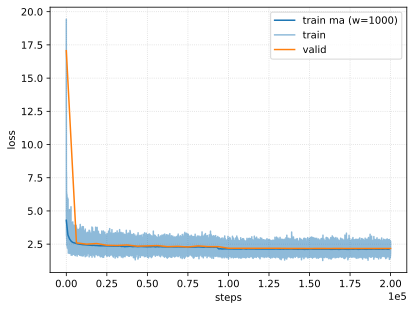

In [11]:
plot_training_results(hist)

Note that the loss starts with a large value. From the network architecture we have an idea that the loss should be around `-log 1/27` or 3+ since the network should ideally start with uniform predict probability over the characters. High loss at the start here is a sign of poor initialization.

In [12]:
# Global dict for monitoring incremental progress
results = {}

def update_results(model, message, plot=False):
    results[message] = {
        'train': engine.evaluate(model, 'train'),
        'valid': engine.evaluate(model, 'valid')
    }

    print(message)
    print(f"train loss: {results[message]['train']:.3f}")
    print(f"valid loss: {results[message]['valid']:.3f}")
    
    if plot:
        messages = list(results.keys())
        x_train = pd.DataFrame(results).loc['train'].index
        y_train = pd.DataFrame(results).loc['train'].values
        x_valid = pd.DataFrame(results).loc['valid'].index
        y_valid = pd.DataFrame(results).loc['valid'].values

        plt.figure(figsize=(9, 5))
        plt.plot(x_train, y_train, label='train', marker="o", color="C0", markeredgecolor="black")
        plt.plot(x_valid, y_valid, label='valid', marker="o", color="C1", markeredgecolor="black")
        plt.ylabel('loss')
        plt.legend();

        for i, message in enumerate(results.keys()):
            if i == 0:
                text_train = results[message]['train']
                text_valid = results[message]['valid']
            else:
                text_train = results[message]['train'] - results[messages[i-1]]['train']
                text_valid = results[message]['valid'] - results[messages[i-1]]['valid']
            
            plt.annotate(f'{text_train:.3f}', (x_train[i], y_train[i]-0.017), ha='center')
            plt.annotate(f'{text_valid:.3f}', (x_valid[i], y_valid[i]-0.017), ha='center')

        plt.ylim(min(min(y_train), min(y_valid))-0.05, max(max(y_train), max(y_valid))+0.05)
        plt.grid(linestyle='dashed', alpha=0.5);

In [13]:
# Monitoring our progress
update_results(model_base, 'emb+MLP', plot=False)

emb+MLP
train loss: 2.118
valid loss: 2.175


### Fixing logits weights

Recall that variance of independent neurons adds up in the wide hidden layer resulting in high logits variance. If the logits have high variance, the output of the softmax layer tends towards a one-hot vector since the exponential function does not scale linearly with input. This model is more likely to have high cross-entropy due to being more confident in the wrong class. This can be seen below:

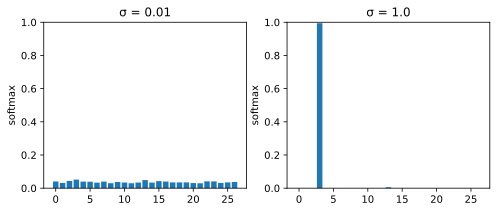

In [14]:
w_logits = torch.randn(size=(200, 27))
x_logits = torch.randn(size=(32, 200))

fig, ax = plt.subplots(1, 2, figsize=(8, 3))
ax[0].bar(range(27), F.softmax(x_logits @ (0.01 * w_logits))[0]);
ax[1].bar(range(27), F.softmax(x_logits @ (1.00 * w_logits))[0]);
ax[0].set_ylabel("softmax")
ax[1].set_ylabel("softmax")
ax[0].set_title("σ = 0.01")
ax[1].set_title("σ = 1.0")
ax[0].set_ylim(0, 1)
ax[1].set_ylim(0, 1);

Scaling the weights of the logits layer to a smaller range:

Setting learning rate to 4.805e-02.


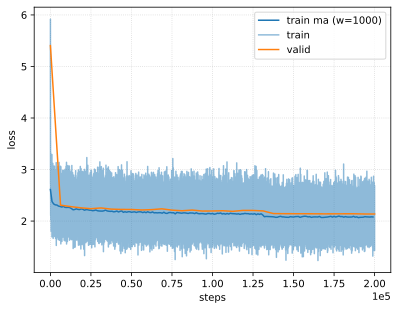

In [15]:
model_logits = MLP(
    embedding_size=10, width=200, block_size=3, 
    scale_logits=lambda fan_in, fan_out: 0.01
)

hist = engine.run(model_logits, 200000, verbose=False, lr_find=True)
plot_training_results(hist)

The network has the same architecture but now starts training with significantly lower loss. This allows the model to focus more on prediction errors, instead of wasting training steps squashing the logits that are large during initialization.

In [16]:
update_results(model_logits, message='fix: logits')

fix: logits
train loss: 2.075
valid loss: 2.137


### Flat activation regions

The next thing to check are activations in the hidden layer. Reinitializing the network:

In [17]:
model = MLP(
    embedding_size=10, width=200, block_size=3, 
    scale_hidden=lambda fan_in, fan_out: 5.00,
    scale_logits=lambda fan_in, fan_out: 0.01
)

Passing one random mini batch:

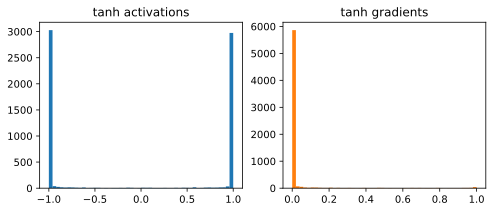

In [18]:
B = torch.randint(0, x_train.shape[0], (32,)) 
model(x_train[B])
h_act = model.out['h_act']

fig, ax = plt.subplots(1, 2, figsize=(8, 3))
ax[0].hist(h_act.reshape(-1).tolist(), bins=50, label='activations');
ax[1].hist((1 - h_act.reshape(-1)**2).tolist(), bins=50, color="C1", label='grads')
ax[0].set_title('tanh activations')
ax[1].set_title('tanh gradients');

This is due to large preactivations for Tanh. The local gradients are zero for regions where Tanh activation values saturate to $\pm 1.$ This can be seen from the histogram of local gradients. 
Indeed, in flat regions changing the preactivations by a small amount does not change the Tanh activations too much, and therefore has negligible impact on the loss. By extension, the corresponding weights and biases also get zero gradients.

### Dead neurons

Another way to visualize this is as follows. Here dark blocks indicate an activation where gradients are small. A **dead neuron** is a neuron whose gradient is mostly zero over the training examples. This can be indicated here by a dark column which means small gradients over the batch. This can occur not only for Tanh but for other nonlinearities which have flat activation regions such as ReLU. Dead neurons can sometimes happen at initialization:

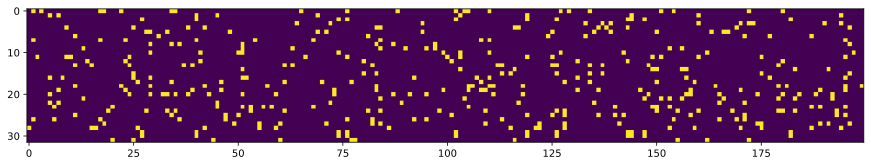

In [19]:
TANH_ACT_THRESHOLD = 0.97

# yellow = alive, dark = saturated
plt.figure(figsize=(15, 3))
plt.imshow(h_act.abs() > TANH_ACT_THRESHOLD, cmap='viridis_r'); 

**Remark.** Dead neurons are can also happen during training. For instance, a high learning rate can knock result in large weights that saturate the neurons similar to the situation above. Note that dead neurons tend to remain dead for a long time since weight gradients are too small to significantly change the existing weights.

### Fixing the saturated Tanh

An easy way to fix saturated Tanh is to simply reduce the range of preactivation values:

In [20]:
model_tanh = MLP(
    embedding_size=10, width=200, block_size=3, 
    scale_hidden=lambda fan_in, fan_out: 0.2,
    scale_logits=lambda fan_in, fan_out: 0.01
)

Passing one mini-batch:

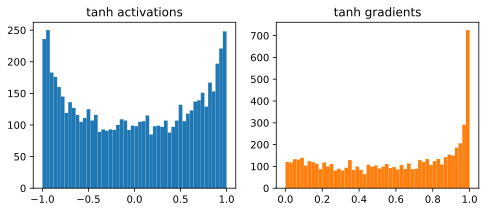

In [21]:
B = torch.randint(0, x_train.shape[0], (32,)) 
model_tanh(x_train[B])
h_act = model_tanh.out['h_act']

fig, ax = plt.subplots(1, 2, figsize=(8, 3))
ax[0].hist(h_act.reshape(-1).tolist(), bins=50);
ax[1].hist((1 - h_act.reshape(-1)**2).tolist(), bins=50, color="C1")
ax[0].set_title('tanh activations')
ax[1].set_title('tanh gradients');

By lowering preactivation values, we get Tanh activation values that are not saturated. Consequently, we have more nonzero gradients. Full training with better initialization:

In [22]:
engine.run(model_tanh, n_steps=200000, verbose=False, lr_find=True)
update_results(model_tanh, message='fix: tanh')

Setting learning rate to 8.412e-02.
fix: tanh
train loss: 2.035
valid loss: 2.104


### Xavier initialization

Note that the scale factors for the weights can be difficult to choose optimally. Indeed, this is just to motivate the more precise initialization scheme that we will develop here. Observe that the output $\boldsymbol{\mathsf{y}} = \boldsymbol{\mathsf{x}}^\top \boldsymbol{\mathsf{w}}$ for normally distributed $\boldsymbol{\mathsf{x}}$ and $\boldsymbol{\mathsf{w}}$ starts to spread out. This makes sense since we are adding $n$ terms where $n$ is the width of the layer.

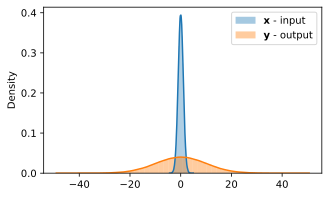

In [23]:
import seaborn as sns

x = torch.randn(1000, 100)
w = torch.randn( 100, 200)
y = x @ w

plt.figure(figsize=(5, 3))
sns.distplot(x.reshape(-1), color="C0", label='$\mathbf{x}$ - input');
sns.distplot(y.reshape(-1), color="C1", label='$\mathbf{y}$ - output');
plt.legend();

```{margin}
**Xavier initialization**
```

Ideally, we want $\boldsymbol{\mathsf{y}}$ to have unit standard deviation to maintain stable activation flow. Otherwise, activations will recursively grow at each layer. This becomes increasingly problematic for deep networks. One straightforward fix is to initialize the weights $\boldsymbol{\mathsf{w}}$ with a distribution having $\sigma^2=\frac{1}{n}$ where $n$ is the width of the layer {cite}`xavier`. Note that setting the standard deviation turns out to be equivalent to just scaling the random variable with $\frac{1}{\sqrt{n}}$ by linearity of expectation:

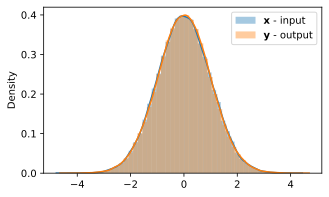

In [24]:
n = 100
x = torch.randn(1000, n)
w = torch.randn(n, 200) / n**0.5
y = x @ w

plt.figure(figsize=(5, 3))
sns.distplot(x.reshape(-1), color="C0", label='$\mathbf{x}$ - input');
sns.distplot(y.reshape(-1), color="C1", label='$\mathbf{y}$ - output');
plt.legend();

```{margin}
**Weight init with gain**
```

Note that this scale factor only holds for linear layers. Nonlinear activations **squashes** its input which compounds as we stack layers in deep networks. To counteract this, an easy fix is to introduce a factor called [gain](https://pytorch.org/docs/stable/nn.init.html#torch.nn.init.calculate_gain) on the standard deviation of the weights to compensate for the squashing effect, i.e. $\sigma_{\boldsymbol{\mathsf{w}}} = \mathsf{g} \frac{1}{\sqrt{n}}$ for some $\mathsf{g} > 0.$ Note that $\mathsf{g}$ for an activation is a heuristic that is usually obtained by performing [empirical tests](https://github.com/pytorch/pytorch/issues/24991). 

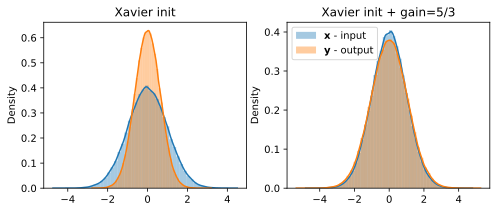

In [25]:
fig, ax = plt.subplots(1, 2, figsize=(8, 3))

n = 100
x = torch.randn(1000, n)
w = torch.randn(n, 200) / n**0.5
y = torch.tanh(x) @ w

sns.distplot(x.reshape(-1), ax=ax[0], color="C0", label='$\mathbf{x}$ - input');
sns.distplot(y.reshape(-1), ax=ax[0], color="C1", label='$\mathbf{y}$ - output');
ax[0].set_title("Xavier init")

x = torch.randn(1000, n)
w = torch.randn(n, 200) * (5/3) / n**0.5
y = torch.tanh(x) @ w

sns.distplot(x.reshape(-1), ax=ax[1], color="C0", label='$\mathbf{x}$ - input');
sns.distplot(y.reshape(-1), ax=ax[1], color="C1", label='$\mathbf{y}$ - output');

ax[1].set_title("Xavier init + gain=5/3")
ax[1].legend();

Applying this to our network:

Setting learning rate to 8.648e-02.


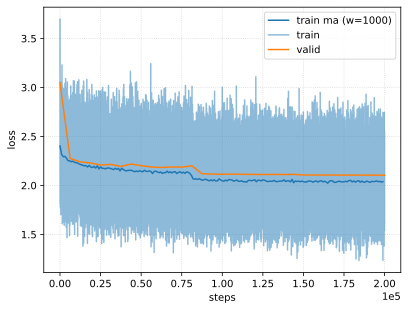

In [26]:
model_xavier = MLP(
    embedding_size=10, width=200, block_size=3, 
    scale_hidden=lambda fan_in, fan_out: (5 / 3) / fan_in ** 0.5,
    scale_logits=lambda fan_in, fan_out: 1 / fan_in ** 0.5
)

hist = engine.run(model_xavier, 200000, verbose=False, lr_find=True)
plot_training_results(hist)

fix: xavier+gain
train loss: 2.039
valid loss: 2.105


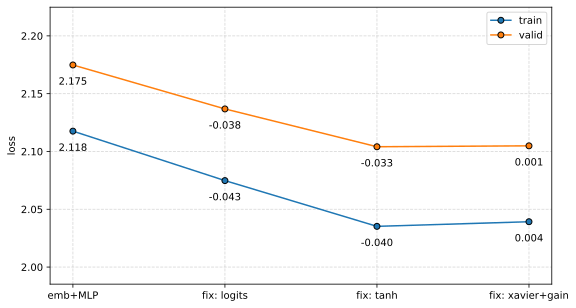

In [27]:
update_results(model_xavier, message="fix: xavier+gain", plot=True)

The last increment here can just be random noise. But what is important is that we now have a semi-principled approach to initializing the weights instead of using arbitrary factors. This will serve as a guide to scale us to much bigger and deeper networks. 

**Remarks.** Gradients also need to have stable flow across the layers. It turns out that for a linear layer $\sigma^2_{\boldsymbol{\mathsf{w}}}=\frac{1}{n_{\text{out}}}$ works where $n_{\text{out}}$ is the number of output neurons. This makes sense since gradients flow in the reverse direction is also matrix multiplication {eq}`backprop-output`. To include the constraints in both directions, a straightforward approach is to use the harmonic mean $\sigma^2_{\boldsymbol{\mathsf{w}}}=\frac{2}{n_{\text{in}} + n_{\text{out}}}.$ 

## Batch Normalization

Note that we went quickly through initialization techniques in the previous section. The math for weight initialization can very quickly become intractable for layers much more complex than fully-connected layers.
This method does not scale well with the invention of new layers. In practice it is much easier to use **Batch Normalization** (BN) {cite}`batchnorm` which allows network layers to have stable activation distribution regardless of depth without the need for extensive tuning ({numref}`resnet-nicepic`). The idea is that if we want stable activations during training, then we should normalize layer preactivations at runtime (e.g. using [standard scaling](https://scikit-learn.org/stable/modules/generated/sklearn.preprocessing.StandardScaler.html)). In the context of SGD optimization, this is naturally done in the batch dimension ({numref}`batchnorm-algo1`). This operation turns out to be [differentiable](03-bn-backprop)!

```{figure} ../../img/batchnorm-algo1.png
---
width: 400px
name: batchnorm-algo1
---
Batch normalization operation. {cite}`batchnorm`
```

```{figure} ../../img/resnet-nicepic.png
---
width: 400px
name: resnet-nicepic
---
BatchNorm layers sprinkled between DenseNet blocks {cite}`densenet`.
```

### Implementation

Note that we introduce a `training` flag to determine whether we will update the running statistics or use that obtained using exponential moving average. The rate of how much recent examples affect the moving average is controlled by the `momentum` parameter.

In [28]:
class BatchNorm1d:
    def __init__(self, width, eps=1e-5, momentum=0.1):
        self.eps = eps
        self.momentum = momentum

        # trainable parameters
        self.gamma = torch.ones(width)
        self.beta = torch.zeros(width)
        [p.requires_grad_(True) for _, p in self.parameters()]
        
        # buffers for inference
        self.u_ema = torch.zeros(1, width)
        self.v_ema = torch.ones(1, width)

    def parameters(self):
        return [("gain", self.gamma), ("bias", self.beta)]

    def __call__(self, x, training=False):
        if training:
            # compute batch mean and variance
            u = x.mean(0, keepdim=True)
            v = x.var (0, keepdim=True)
            
            with torch.no_grad(): # update buffers
                self.u_ema = (1 - self.momentum) * self.u_ema + self.momentum * u
                self.v_ema = (1 - self.momentum) * self.v_ema + self.momentum * v
        else:
            # use buffers for inference
            u = self.u_ema
            v = self.v_ema

        self.xhat = (x - u) / torch.sqrt(v + self.eps)
        self.out = self.gamma * self.xhat + self.beta
        return self.out

Forcing preactivations to be normal limits the expressivity of the neurons. As the network learns, we want to move the preactivation distributions around so that the neurons have more complex activation patterns. This is done using learnable parameters `beta` and `gamma` that control the scale and shift of each output neurons. During inference we will use the EMA estimate for batch mean `u` and variance `v` which are non-trainable parameters (i.e. not learned with SGD).
These tensors have size equal to the width of the layer (i.e. one for each output neuron). Note that this means BN has different behaviors during training and inference.

## Effects of BatchNorm

Here we define layers for our networks. Note that the bias of the linear layers preceding BatchNorm can be removed (i.e. setting to `bias=False`). BN subtracts these out anyway and is compensated by the bias of the BatchNorm layer.

In [29]:
class Embedding:
    def __init__(self, embedding_size: int, vocab_size=27):
        self.embedding_size = embedding_size
        self.vocab_size = vocab_size
        self.C = torch.randn(vocab_size, embedding_size, requires_grad=True)

    def __call__(self, x, training=False):
        block_size = x.shape[1]
        self.out = self.C[x].view(-1, block_size * self.embedding_size)
        return self.out

    def parameters(self):
        return [("weights", self.C)]


class Linear:
    def __init__(self, 
            fan_in: int, fan_out: int, 
            gain=1.0,
            bias=True
        ):
        self.W = torch.randn((fan_in, fan_out)) * gain / (fan_in ** 0.5)
        self.b = torch.zeros(fan_out) if bias else None
        for _, p in self.parameters():
            p.requires_grad = True

    def __call__(self, x, training=False):
        self.out = x @ self.W
        if self.b is not None:
            self.out += self.b
        return self.out

    def parameters(self):
        return [("weights", self.W)] + ([("bias", self.b)] if self.b is not None else [])


class Tanh:
    def __call__(self, x, training=False):
        self.out = torch.tanh(x)
        return self.out

    def parameters(self):
        return []


class DeepMLP:
    def __init__(self, embedding_size, block_size, layers, vocab_size=27):

        self.embedding_size = embedding_size
        self.block_size = block_size
        self.vocab_size = vocab_size
        
        self.emb = Embedding(embedding_size, vocab_size)
        self.layers = [(self.emb.__class__.__name__+".0", self.emb)] + \
            [(l.__class__.__name__+f".{i+1}", l) for i, l in enumerate(layers)]
        
    def parameters(self):
        params = []
        for layer_name, layer in self.layers:
            for param_name, param in layer.parameters():
                params.append((f'{layer_name}.{param_name}', param))
        return params

    def __call__(self, x, training=False):
        for _, layer in self.layers:
            x = layer(x, training)
        return x

    def zero_grad(self):
        for _, param in self.parameters():
           param.grad = None

Defining callbacks that compute certain metrics for monitoring training:

In [30]:
class ParamUpdateRatio:
    def init(self, model):
        self.param_update_ratio = {} 
        for n, _ in model.parameters():
            if "weights" in n:
                self.param_update_ratio[n] = []

    @torch.no_grad()
    def step(self, model, step, **kwargs):
        lr = kwargs["lr"]
        for n, p in model.parameters():
            if "weights" in n:
                update_ratio = ((lr * p.grad).std() / p.data.std()).log10().item()
                self.param_update_ratio[n].append((step, update_ratio))


class GradientMagnitude:
    def init(self, model):
        self.grad_magnitude = {}
        for n, l in model.layers:
            if isinstance(l, Linear) or isinstance(l, Embedding):
               self.grad_magnitude[n] = []
    
    @torch.no_grad()
    def step(self, model, step, **kwargs):
        for n, l in model.layers:
            if isinstance(l, Linear) or isinstance(l, Embedding):
                g = l.out.grad
                v = torch.linalg.norm(g, dim=1).mean()
                self.grad_magnitude[n].append((step, v.item()))


class SingularValuesRatio:
    def init(self, model):
        self.sv_ratio = {}
        for n, l in model.layers:
            if isinstance(l, Linear) or isinstance(l, Embedding):
                self.sv_ratio[n + '.out'] = []
                self.sv_ratio[n + '.out.grad'] = []
                self.sv_ratio[n + '.weights'] = []
                self.sv_ratio[n + '.weights.grad'] = []

    @torch.no_grad()
    def step(self, model, step, **kwargs):
        if step % 20 == 0:
            for n, l in model.layers:
                if isinstance(l, Linear) or isinstance(l, Embedding):
                    try:
                        z = torch.linalg.svd(l.out)[1]
                        self.sv_ratio[n + '.out'].append((step, (z[0] / z.sum()).item()))
                    except:
                        continue
                    try:
                        g = torch.linalg.svd(l.out.grad)[1]
                        self.sv_ratio[n + '.out.grad'].append((step, (g[0] / g.sum()).item()))
                    except:
                        continue

            for n, p in model.parameters():
                if "weights" in n:
                    try:
                        w = torch.linalg.svd(p)[1]
                        self.sv_ratio[n].append((step, (w[0] / w.sum()).item()))
                    except:
                        continue
                    try:
                        g = torch.linalg.svd(p.grad)[1]
                        self.sv_ratio[n + '.grad'].append((step, (g[0] / g.sum()).item()))
                    except:
                        continue

monitors = [
    ParamUpdateRatio(), 
    GradientMagnitude(),
    SingularValuesRatio()
]

Minimal training script for monitoring model training. Recall that PyTorch discards gradients of non-leaf tensors by default so we have to use `.retain_grad()` on the output tensors of each layer to retain gradients.

In [31]:
def monitor_training(model, x_train, y_train, n_steps, monitors, bs=32, lr=0.1):
    """Monitoring model training."""

    for m in monitors:
        m.init(model)

    loss_train = {}

    for k in range(n_steps):
        B = torch.randint(0, x_train.shape[0], (bs,))
        logits = model(x_train[B], training=True)
        loss = F.cross_entropy(logits, target=y_train[B])

        for _, layer in model.layers:
            layer.out.retain_grad()

        model.zero_grad()
        loss.backward()
        for _, p in model.parameters():
            p.data -= lr * p.grad
        
        loss_train[k] = loss.item()
        for m in monitors:
            m.step(model, k, lr=lr)

    return {
        "train": loss_train, 
        "valid": [],
        "param_update_ratio":    monitors[0].param_update_ratio,
        "gradient_magnitude":    monitors[1].grad_magnitude,
        "singular_values_ratio": monitors[2].sv_ratio
    }

Setting the linear layers to have no bias. Bias tensors of linear layers will have zero gradients flowing into it since they do not affect the output of the model (i.e. biases in the linear layer only wastes compute resources). Note also that it can also help to use BatchNorm on the logits:

In [32]:
block_size     = 3
vocab_size     = 27
width          = 100
embedding_size = 10

inp = embedding_size * block_size
out = vocab_size

LOW_GAIN  = 0.4
HIGH_GAIN = 3.0
TANH_GAIN = 5/3


def create_nobn_model(gain, activation, n_hidden):
    inputs = [ Linear(inp,   width, gain=gain), activation()]
    hidden = [[Linear(width, width, gain=gain), activation()] for _ in range(n_hidden)]
    logits = [ Linear(width, out,   gain=0.1)]   # logits: make less confident
    layers = inputs + sum(hidden, []) + logits
    
    model = DeepMLP(embedding_size, block_size, layers, vocab_size)
    return model

def create_bn_model(gain, activation, n_hidden):
    inputs = [ Linear(inp,   width, gain=gain, bias=False), BatchNorm1d(width), activation()]
    hidden = [[Linear(width, width, gain=gain, bias=False), BatchNorm1d(width), activation()] for _ in range(n_hidden)] 
    logits = [ Linear(width, out,   gain=gain, bias=False), BatchNorm1d(vocab_size)]
    layers = inputs + sum(hidden, []) + logits

    # Make logits less confident
    with torch.no_grad():
        layers[-1].gamma *= 0.1

    model = DeepMLP(embedding_size, block_size, layers, vocab_size)
    return model

def create_model(activation, gain: float, batch_norm: bool, n_hidden: int):
    model = create_bn_model(gain, activation, n_hidden) if batch_norm else create_nobn_model(gain, activation, n_hidden)
    return model

Note the setting `bias=False` for linear layers. Packaging the configuration and results of experiments in a dataclass:

In [33]:
from dataclasses import dataclass, field, asdict
from typing import Any


@dataclass
class ExperimentConfig:
    gain: float
    batch_norm: bool
    activation: Any = field(default=Tanh)
    n_hidden: int = 4
    x_train = x_train
    y_train = y_train
    n_steps: int = 1000
    bs: int = 32
    lr: float = 0.1
    monitors: list = field(default_factory=[])
        

class Experiment:

    def __init__(self, config: ExperimentConfig):
        self.config = config
        self.model = create_model(
            self.config.activation, 
            self.config.gain, 
            self.config.batch_norm,
            self.config.n_hidden
        )
        self.name = self._build_name()

    def run(self, verbose=True):
        self.hist = monitor_training(
            model=self.model, 
            x_train=self.config.x_train, 
            y_train=self.config.y_train, 
            n_steps=self.config.n_steps,
            monitors=self.config.monitors,
            bs=self.config.bs,
            lr=self.config.lr,
        )

    def _build_name(self):
        n = []
        for k in asdict(self.config).keys():
            v = getattr(self.config, k)
            if k == "gain":
                n.append(f"{k}={v:.2f}")
            elif k == "lr":
                n.append(f"{k}={v:.0e}")
            elif k == "activation":
                n.append(f"act={str(v).split('.')[-1][:-2]}")
            elif k == "batch_norm":
                n.append(f"BN={str(v):<5}")
            elif k == "monitors":
                continue
            else:
                n.append(f"{k}={v}")
        return ", ".join(n)

Note the setting `bias=False` for linear layers. Our goal is to show that networks without BatchNorm depend on a precise setting of the gains for its weight initialization. To do this, we train a network with the recommended 5/3 gain in PyTorch for Tanh, as well as networks with lower and higher gains. We will then add BatchNorm layers and check how it affects training behavior.

In [34]:
from itertools import product

experiments = []
for lr, gain, bn in product([0.01, 0.1, 1.0, 10.0], [HIGH_GAIN, TANH_GAIN, LOW_GAIN], [False, True]):
    config = ExperimentConfig(gain, bn, n_hidden=4, n_steps=5000, lr=lr, monitors=monitors)
    e = Experiment(config)
    e.run(verbose=False)
    experiments.append(e)
    print(e.name)

gain=3.00, BN=False, act=Tanh, n_hidden=4, n_steps=5000, bs=32, lr=1e-02
gain=3.00, BN=True , act=Tanh, n_hidden=4, n_steps=5000, bs=32, lr=1e-02
gain=1.67, BN=False, act=Tanh, n_hidden=4, n_steps=5000, bs=32, lr=1e-02
gain=1.67, BN=True , act=Tanh, n_hidden=4, n_steps=5000, bs=32, lr=1e-02
gain=0.40, BN=False, act=Tanh, n_hidden=4, n_steps=5000, bs=32, lr=1e-02
gain=0.40, BN=True , act=Tanh, n_hidden=4, n_steps=5000, bs=32, lr=1e-02
gain=3.00, BN=False, act=Tanh, n_hidden=4, n_steps=5000, bs=32, lr=1e-01
gain=3.00, BN=True , act=Tanh, n_hidden=4, n_steps=5000, bs=32, lr=1e-01
gain=1.67, BN=False, act=Tanh, n_hidden=4, n_steps=5000, bs=32, lr=1e-01
gain=1.67, BN=True , act=Tanh, n_hidden=4, n_steps=5000, bs=32, lr=1e-01
gain=0.40, BN=False, act=Tanh, n_hidden=4, n_steps=5000, bs=32, lr=1e-01
gain=0.40, BN=True , act=Tanh, n_hidden=4, n_steps=5000, bs=32, lr=1e-01
gain=3.00, BN=False, act=Tanh, n_hidden=4, n_steps=5000, bs=32, lr=1e+00
gain=3.00, BN=True , act=Tanh, n_hidden=4, n_steps=

### Loss curves

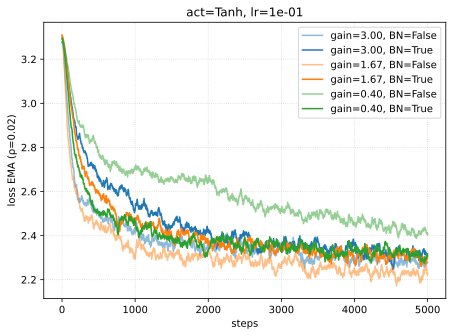

In [35]:
def filter_name(name: str, config_keys: list[str] = None):
    """Technical utility for filtering config variables from names."""
    if config_keys:
        return ", ".join([n for n in name.split(', ') if n.split('=')[0] in config_keys])
    else:
        return name


def plot_loss_curves(experiments: list[Experiment], momentum: float = 0.1, title_configs=None, label_configs=None):
    for i, exp in enumerate(experiments):
        steps = list(exp.hist['train'].keys())
        loss_ema = ema_inf(list(exp.hist['train'].values()), momentum=momentum)
        alpha = 0.5 if not exp.config.batch_norm else 1.0
        plt.plot(steps, loss_ema, label=filter_name(exp.name, label_configs), color=f"C{i//2}", alpha=alpha, linewidth=1.5)
        
    plt.title(filter_name(exp.name, title_configs))
    plt.xlabel("steps")
    plt.ylabel(f"loss EMA (ρ={momentum})")
    plt.grid(True, alpha=0.5, linestyle="dotted")
    plt.legend()
    plt.tight_layout()


plot_loss_curves([e for e in experiments if e.config.lr == 0.1], momentum=0.02, title_configs=["act", "lr"], label_configs=["gain", "BN"])

**Figure.** Loss curves for experiments with high / low gain + BN behaving similarly with gain 5/3 for Tanh indicates that having BatchNorm layers result in better training at initialization despite suboptimal weight initialization. This suggests that a careful choice of gain is not necessary when using BatchNorm.

### Activation distribution

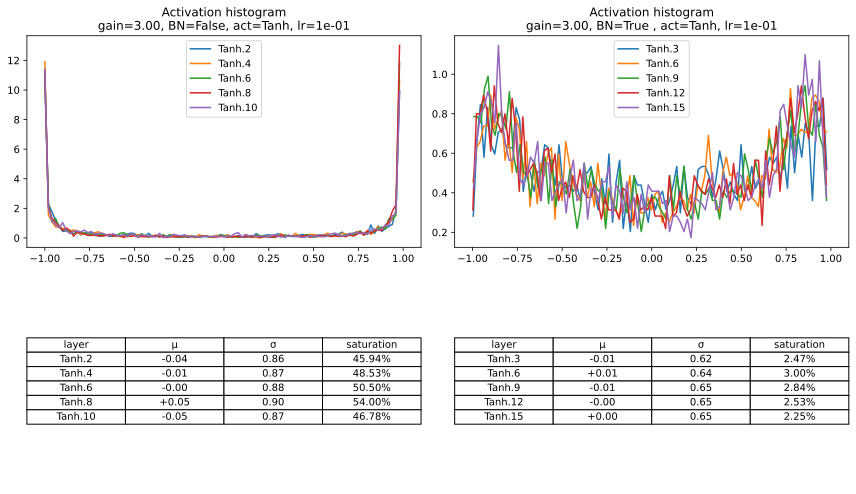

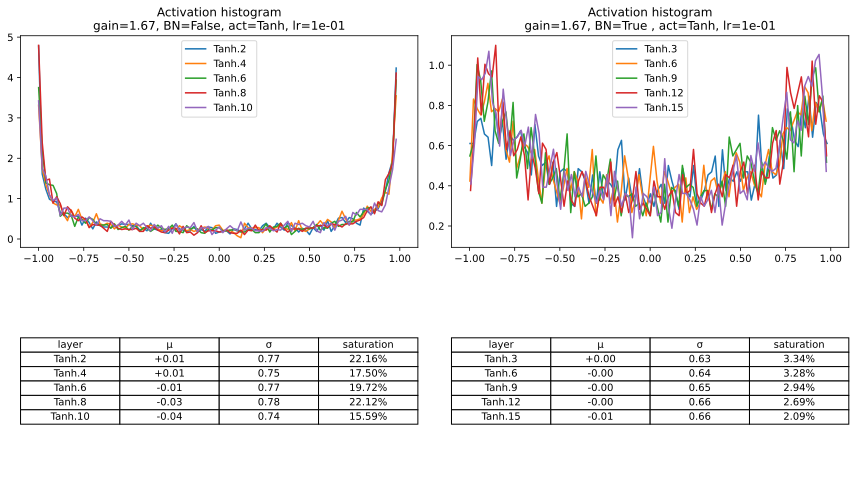

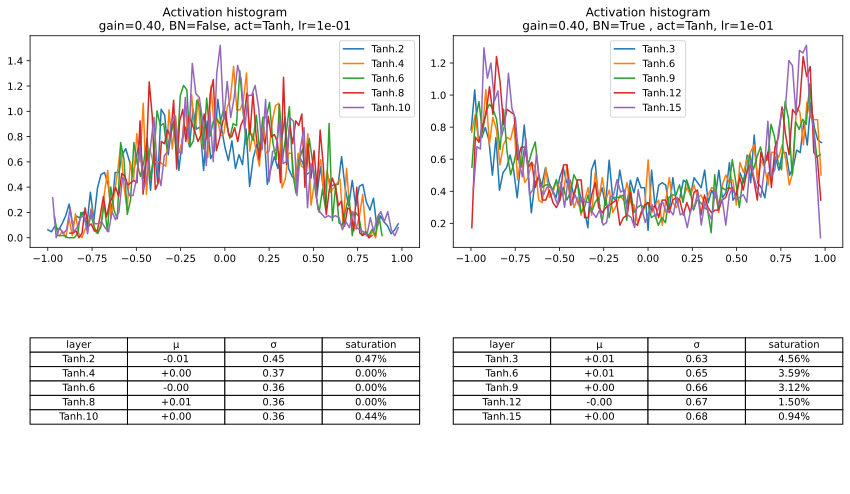

In [36]:
def _activation_histogram(ax, table, experiment: Experiment, xlim=None, saturation_fn=None, title_configs=None):
    
    if saturation_fn is None and experiment.config.activation is Tanh:
        saturation_fn = lambda x: x.abs() > math.atanh(TANH_ACT_THRESHOLD)
    
    σs = []
    messages = {'layer': [], 'μ': [], 'σ': [], 'saturation': []}
    for i, (layer_name, layer) in enumerate(experiment.model.layers[:-1]):  # Exclude logits / output layer.
        if isinstance(layer, experiment.config.activation):
            t = layer.out
            x = experiment.model.layers[i-1][1].out
            saturation = saturation_fn(x).float().mean()
            
            messages['layer'].append(layer_name)
            messages['μ'].append(f'{t.mean():+.2f}')
            messages['σ'].append(f'{t.std():.2f}')
            messages['saturation'].append(f'{saturation * 100:.2f}%')
            
            σs.append(t.std().abs())
            hy, hx = torch.histogram(t, density=True)
            ax.plot(hx[:-1].detach(), hy.detach(), label=layer_name)
    
    title = filter_name(experiment.name, title_configs)
    ax.set_title(f'Activation histogram\n{title}')
    ax.legend()
    
    σ_max = max(σs).item()
    if xlim is None:
        ax.set_xlim(-3*σ_max, 3*σ_max)
    else:
        ax.set_xlim(-xlim, xlim)

    df = pd.DataFrame(messages)
    table.axis('tight')
    table.axis('off')
    table.table(cellText=df.values, colLabels=df.columns, loc='center', cellLoc='center')


def plot_activation_histograms(experiments: list[Experiment], xlim=None, saturation_fn=None, title_configs=None):
    fig, ax = plt.subplots(2, 2, figsize=(12, 7))
    _activation_histogram(ax[0, 0], ax[1, 0], experiments[0], xlim, saturation_fn, title_configs)
    _activation_histogram(ax[0, 1], ax[1, 1], experiments[1], xlim, saturation_fn, title_configs)
    fig.tight_layout()
    plt.show()


for g in [HIGH_GAIN, TANH_GAIN, LOW_GAIN]:
    plot_activation_histograms(
        [e for e in experiments if e.config.lr == 0.1 and e.config.gain == g], 
        xlim=1.1, title_configs=["act", "gain", "BN", "lr"]
    )

**Figure.** Histogram of activation values at the final training step for each layer. Large gain results in saturated activations. On the other hand, low gain results in decreasing range of activation values. Choosing a good value for the gain, balances these effects as shown by the middle graph. Indeed, recall that we introduced gain to balance out the squashing effect of activations. BatchNorm layers control the amount of saturation to around 3% which can be helpful for training. But also with a good range (`σ = 0.65`) that is stable with depth regardless of gain.

### Activation gradients

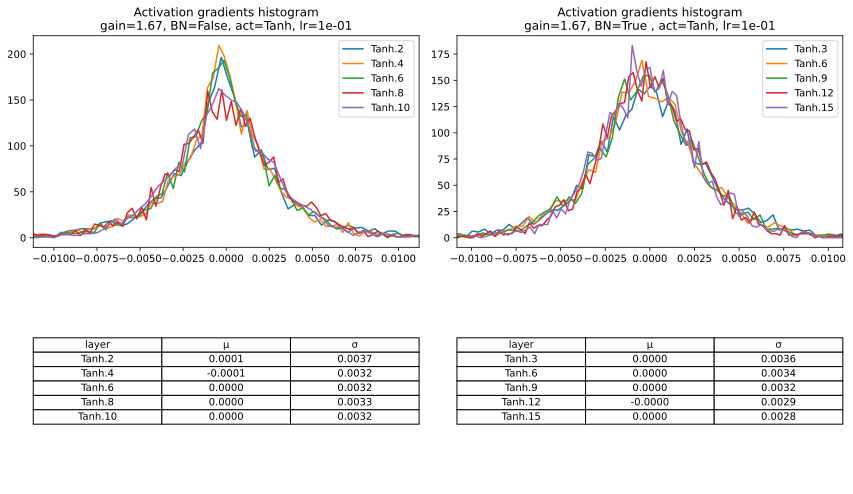

In [37]:
def _activation_gradient(ax, table, experiment, title_configs):
    σs = []
    messages = {'layer': [], 'μ': [], 'σ': []}
    for layer_name, layer in experiment.model.layers[:-1]: # Exclude logits / output layer.
        if isinstance(layer, experiment.config.activation):
            t = layer.out.grad
            σs.append(t.std().abs())
            messages['layer'].append(layer_name)
            messages['μ'].append(f'{t.mean():.4f}')
            messages['σ'].append(f'{t.std():.4f}')         
            hy, hx = torch.histogram(t, density=True)
            ax.plot(hx[:-1].detach(), hy.detach(), label=layer_name)

    σ_max = max(σs).item()
    ax.set_xlim(-3*σ_max, 3*σ_max)
    ax.legend()
    title = filter_name(experiment.name, title_configs)
    ax.set_title(f'Activation gradients histogram\n{title}')

    df = pd.DataFrame(messages)
    table.axis('tight')
    table.axis('off')
    table.table(cellText=df.values, colLabels=df.columns, loc='center', cellLoc='center')


def plot_gradient_histograms(experiments: list[Experiment], title_configs=None):
    fig, ax = plt.subplots(2, 2, figsize=(12, 7))
    _activation_gradient(ax[0, 0], ax[1, 0], experiments[0], title_configs)
    _activation_gradient(ax[0, 1], ax[1, 1], experiments[1], title_configs)
    fig.tight_layout()
    plt.show()


plot_gradient_histograms(
    [e for e in experiments if e.config.lr == 0.1 and e.config.gain == TANH_GAIN], 
    title_configs=["act", "gain", "BN", "lr"]
)

**Figure.** Gradients of activations at the final training step for each layer. Note that the gradient distribution is not stable in the unnormalized network from visual inspection. This is fixed by using BatchNorm. 

### Weight gradients

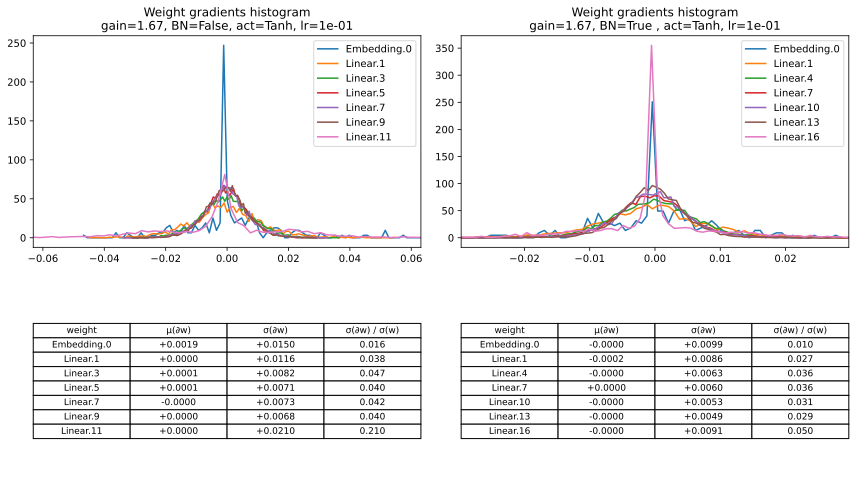

In [38]:
def _weight_gradients(ax, table, experiment: Experiment, title_configs):
    σs = []
    messages = {'weight': [], 'μ(∂w)': [], 'σ(∂w)': [], 'σ(∂w) / σ(w)': []}
    for param_name, param in experiment.model.parameters():
        if "weights" in param_name:
            σs.append(param.grad.std())
            messages['weight'].append(f'{param_name[:-8]}')
            messages['μ(∂w)'].append(f'{param.grad.mean():+.4f}')
            messages['σ(∂w)'].append(f'{param.grad.std() :+.4f}')
            messages['σ(∂w) / σ(w)'].append(f'{param.grad.std() / param.std():.3f}')
            hy, hx = torch.histogram(param.grad, density=True)
            ax.plot(hx[:-1].detach(), hy.detach(), label=param_name[:-len(".weights")])

    σ_max = max(σs).item()
    ax.set_xlim(-3*σ_max, 3*σ_max)
    ax.legend()
    ax.set_title(f'Weight gradients histogram\n{filter_name(experiment.name, title_configs)}')
    
    df = pd.DataFrame(messages)
    table.axis('tight')
    table.axis('off')
    table.table(cellText=df.values, colLabels=df.columns, loc='center', cellLoc='center')


def plot_weight_gradients_histograms(experiments: list[Experiment], title_configs=None):
    fig, ax = plt.subplots(2, 2, figsize=(12, 7))
    _weight_gradients(ax[0, 0], ax[1, 0], experiments[0], title_configs)
    _weight_gradients(ax[0, 1], ax[1, 1], experiments[1], title_configs)
    fig.tight_layout()
    plt.show()


plot_weight_gradients_histograms(
    [e for e in experiments if e.config.lr == 0.1 and e.config.gain == TANH_GAIN],
    ["gain", "BN", "act", "lr"]
)

**Figure.** Histogram of weight gradients at the final training step for each layer. Observe that for unnormalized networks the logits layer trains many times faster than the hidden layers and the embedding layer of the network. This is fixed in the networks with BatchNorm layers.

(03-update-ratio-over-time)=
### Update ratio over time

Recall that we looked at the grad-to-data ratio above for the final training step. Let us look at how this value evolves over the course of training. More precisely, we consider the ratio $\eta = \frac{\sigma(\lambda {\boldsymbol{\mathsf{w}}}_{\nabla})}{\sigma(\boldsymbol{\mathsf{w}})}$ where $\boldsymbol{\mathsf{w}}_{\nabla} = \frac{\partial \mathcal{L}}{\partial \boldsymbol{\mathsf{w}}}$ is the gradient of the loss with respect to the weights with value $\boldsymbol{\mathsf{w}}$. Here we take the standard deviation over the entire matrix. This is only to get a general idea of the range of possible values.

A low update ratio can mean that convergence during training is too slow, while a high value means that the network can unlearn good weight configurations. Having layers with different update ratios may not be good for training as the weights learned by the slower layers can become outdated as the faster layers learn new weights. As a heuristic, the line `y=-3` is indicated corresponding to an update ratio of `0.001` for one mini-batch. For context, the number of steps in an epoch is `182,516 / 32 ~ 6x10^3`.

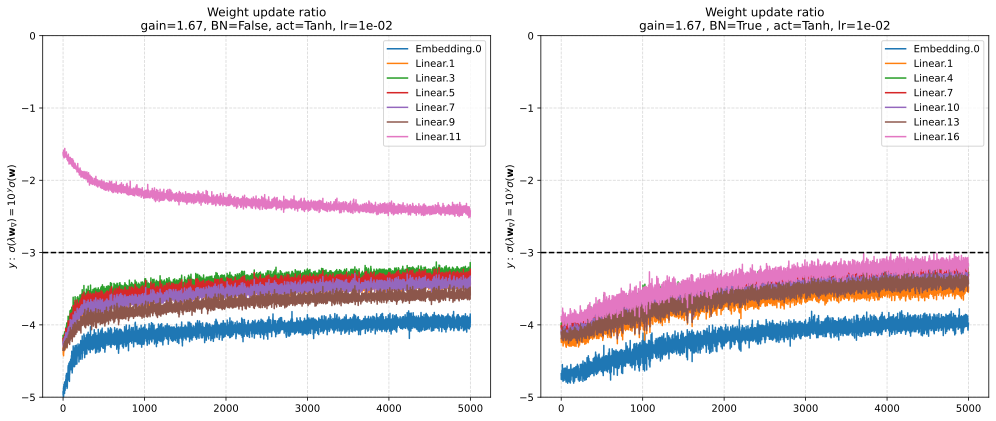

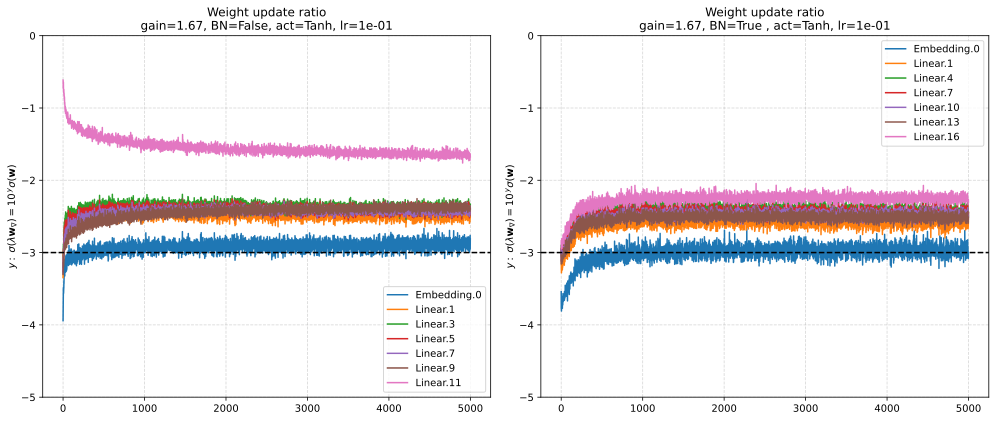

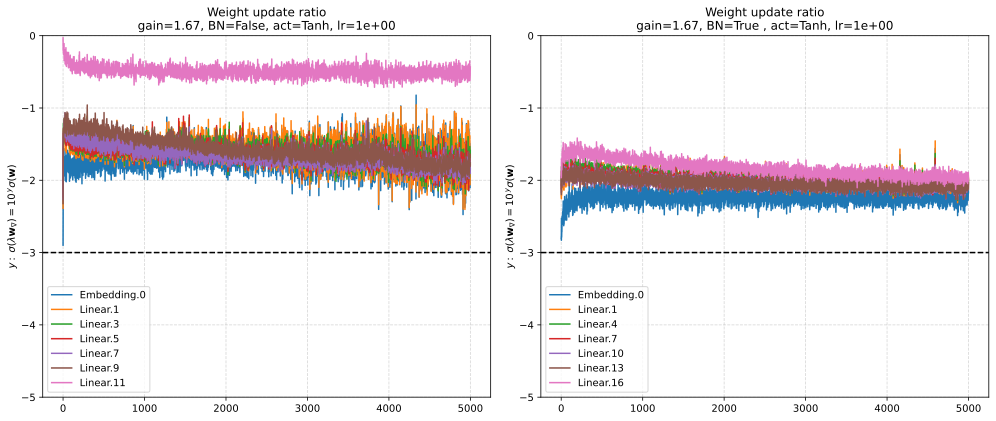

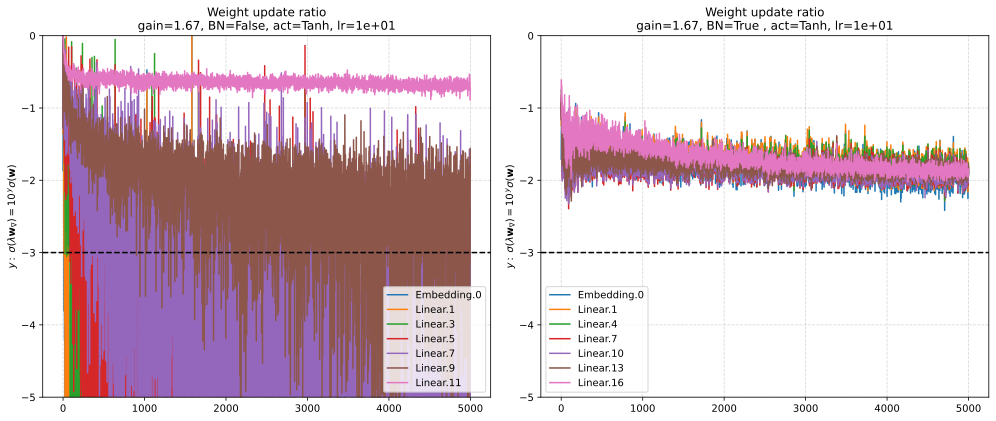

In [39]:
def _update_ratio(ax, experiment: Experiment, title_configs, ylim):

    for param_name, ud in experiment.hist['param_update_ratio'].items():
        if "weights" in param_name:
            x, y = zip(*ud)
            ax.plot(x, y, label=param_name[:-len(".weights")])
    
    ax.axhline(-3, color='k', linestyle='--')
    ax.set_ylim(ylim)
    ax.grid(linestyle='dashed', alpha=0.5);
    ax.set_ylabel(r"$y:\; {\sigma(\lambda {\mathbf{w}}_{\nabla})} = {10}^{\,y} {\sigma(\mathbf{w})}$")
    ax.legend()
    ax.set_title(f"Weight update ratio\n{filter_name(experiment.name, title_configs)}")


def plot_update_ratios(experiments: list[Experiment], title_configs=None, ylim=(-5, 0)):
    fig, ax = plt.subplots(1, 2, figsize=(14, 6))
    _update_ratio(ax[0], experiments[0], title_configs, ylim)
    _update_ratio(ax[1], experiments[1], title_configs, ylim)
    fig.tight_layout()
    plt.show()


for lr in [0.01, 0.1, 1.0, 10.0]:
    plot_update_ratios(
        [e for e in experiments if e.config.lr == lr and e.config.gain == TANH_GAIN],
        ["act", "gain", "BN", "lr"]
    )

**Figure.** As observed in the above weight gradient histogram, the output layer updates faster compared to intermediate MLP layers. BN allows using larger learning rates resulting in higher update ratios (i.e. shifting the update curves upwards) without the network diverging. This can also be observed in the next figure.

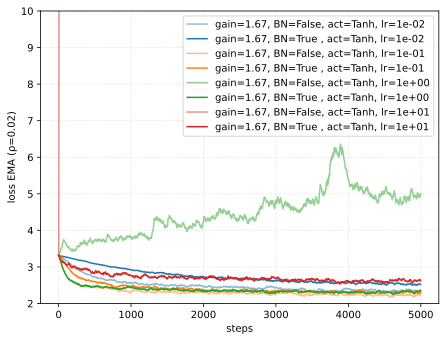

In [40]:
plot_loss_curves([e for e in experiments if e.config.gain == TANH_GAIN], momentum=0.02, label_configs=["act", "gain", "BN", "lr"], title_configs=[""])
plt.ylim(2, 10);

**Figure.** Train loss curves for the experiments in the above figure. Using BatchNorm allows for larger learning rates which accelerates training (e.g. `lr=1` for the green curve) as described in the original paper {cite}`batchnorm`.

## Results with BatchNorm

BatchNorm for the 4 hidden layer network results in little improvement since the network is small and shallow. It's likely that the divergence of forward and backward passes can still be corrected using only good weight initialization, so that BatchNorm is not doing much:

Setting learning rate to 7.960e-02.


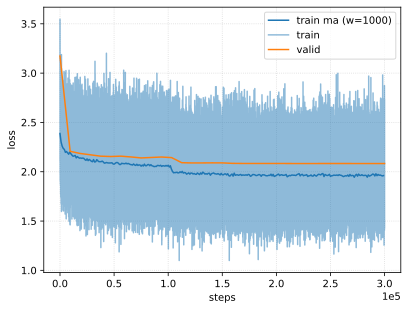

In [41]:
# Training: More steps since its a deeper model
model_no = create_model(activation=Tanh, gain=TANH_GAIN, batch_norm=False, n_hidden=4)
hist = engine.run(model_no, 300000, lr_find=True, verbose=False)
plot_training_results(hist)

Setting learning rate to 3.400e-01.


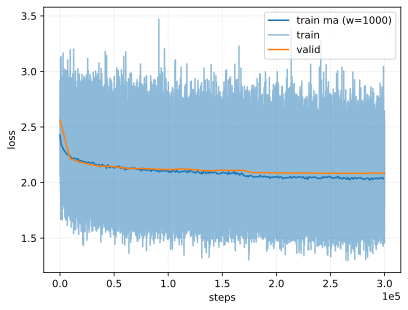

In [42]:
model_bn = create_model(activation=Tanh, gain=TANH_GAIN, batch_norm=True, n_hidden=4)
hist = engine.run(model_bn, 300000, lr_find=True, verbose=False)
plot_training_results(hist)

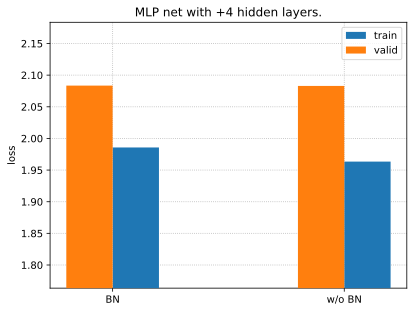

In [43]:
bn_train, bn_valid = engine.evaluate(model_bn, 'train'), engine.evaluate(model_bn, 'valid')
no_train, no_valid = engine.evaluate(model_no, 'train'), engine.evaluate(model_no, 'valid')
x = np.arange(2)

plt.grid(linestyle='dotted')
plt.bar(x + 0.1, [bn_train, no_train], width=0.2, label='train', zorder=3)
plt.bar(x - 0.1, [bn_valid, no_valid], width=0.2, label='valid', zorder=3)
y = [bn_train, bn_valid, no_train, no_valid]
plt.ylim(min(y) - 0.2, max(y) + 0.1)
plt.xticks(x, ['BN', 'w/o BN'])
plt.ylabel("loss")
plt.title("MLP net with +4 hidden layers.")
plt.legend();

Using BN does not improve validation at this depth. Although the network with BN overfits less on the training set which can be good. To really see that BatchNorm makes a difference, we redo this experiment on a deeper network. Note that the deeper requires a lower base learning rate to train:

In [44]:
model_bn12 = create_model(activation=Tanh, gain=TANH_GAIN, batch_norm=True,  n_hidden=12)
model_no12 = create_model(activation=Tanh, gain=TANH_GAIN, batch_norm=False, n_hidden=12)

engine.run(model_bn12, 300000, lr_find=True, verbose=False)
engine.run(model_no12, 300000, lr_find=True, verbose=False);

Setting learning rate to 2.277e-01.
Setting learning rate to 6.249e-02.


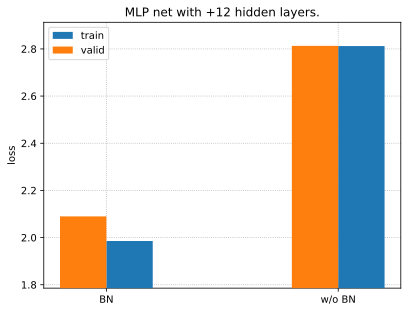

In [45]:
# Plotting
bn_train, bn_valid = engine.evaluate(model_bn12, 'train'), engine.evaluate(model_bn12, 'valid')
no_train, no_valid = engine.evaluate(model_no12, 'train'), engine.evaluate(model_no12, 'valid')
x = np.arange(2)

plt.grid(linestyle='dotted')
plt.bar(x + 0.1, [bn_train, no_train], width=0.2, label='train', zorder=3)
plt.bar(x - 0.1, [bn_valid, no_valid], width=0.2, label='valid', zorder=3)
plt.ylim(1.8, 2.2)
plt.xticks(x, ['BN', 'w/o BN'])
y = [bn_train, bn_valid, no_train, no_valid]
plt.ylim(min(y) - 0.2, max(y) + 0.1)
plt.ylabel("loss")
plt.title("MLP net with +12 hidden layers.")
plt.legend();

Updating the results graph with our model with +4 hidden layers:

fix: BN+depth
train loss: 1.986
valid loss: 2.084


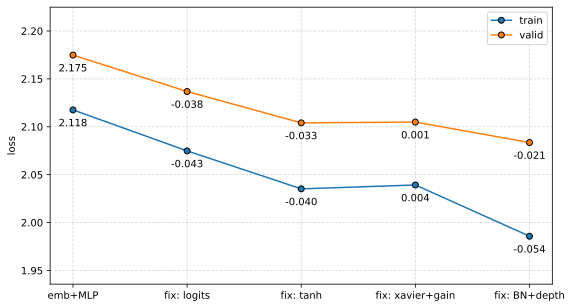

In [46]:
update_results(model_bn, "fix: BN+depth", plot=True)

The network is starting to overfit (i.e. the validation loss is starting to plateau). This tells us that our model is not bottlenecked by the optimization or by depth of the MLP subnetwork. Probably the network is being limited by **block size**. Future notebooks will continue in this direction.

(03-batchnorm-theory)=
## Appendix: More theory

(03-bn-backprop)=
### Backpropagation

Recall that BatchNorm computes the following independently for each neuron across a mini-batch. The layer performs the following computation for each mini-batch $\boldsymbol{\mathsf{z}}_{bj}$ for $b = 1, \ldots, B:$

$$
\begin{aligned}
\boldsymbol{\mu}_j &= \frac{1}{B}\sum_{b} \boldsymbol{\mathsf{z}}_{bj} \\
\boldsymbol{\sigma}^2_j &= \frac{1}{B-1}\sum_{b} (\boldsymbol{\mathsf{z}}_{bj} - \boldsymbol{\mu}_j)^2 \\
\hat{\boldsymbol{\mathsf{z}}}_{bj} &= \frac{\boldsymbol{\mathsf{z}}_{bj} - \boldsymbol{\mu}_j}{\sqrt{\boldsymbol{\sigma}^2_j + \epsilon}} \\
{\boldsymbol{\mathsf{y}}}_{bj} &= \boldsymbol{\gamma}_j\, \hat{\boldsymbol{\mathsf{z}}}_{bj} + \boldsymbol{\beta}_j.
\end{aligned}
$$

The indices are a bit overkill but the notation makes the dependencies unambiguous. When we derive the backpropagation equations later, this is cleaned up by dropping the layer-wise index $j$ for the output neurons. Notice that the dependence only occurs along the batch dimension:

```{figure} ../../img/batchnorm.drawio.svg
---
name: batchnorm.drawio
width: 50%
---
Tracking dependencies for one output neuron. Note that the index $j$ for the output neuron is dropped.
```


As mentioned above, we drop the layer-wise indices. Note that the above figure is a snapshot of one neuron that computes batch statistics of its values along the batch dimension. Our goal is to compute the gradients on its input nodes, so that this can be pushed to previous layers, and the gradients of the trainable parameters $\gamma$ and $\beta$ for SGD updates. 

$$
\begin{aligned}
\frac{\partial \mathcal L}{\partial \sigma^2} &= \sum_b\frac{\partial \mathcal L}{\partial \boldsymbol{\mathsf{y}}_{b}} \frac{\partial \boldsymbol{\mathsf{y}}_{b}}{\partial \sigma^2}
\\
&= \sum_{b} \frac{\partial \mathcal L}{\partial \boldsymbol{\mathsf{y}}_{b}} \gamma\left(\boldsymbol{\mathsf{z}}_{b}-\mu\right) \cdot-\frac{1}{2}\left(\sigma^2+\varepsilon\right)^{-\frac{3}{2}} 
\\
\\
\frac{\partial \mathcal{L}}{\partial \mu}&=\frac{\partial \mathcal{L}}{\partial \sigma^2} \frac{\partial \sigma^2}{\partial \mu}+\sum_b \frac{\partial \mathcal{L}}{\partial \boldsymbol{\mathsf{y}}_{b}}  \frac{\partial \boldsymbol{\mathsf{y}}_{b}}{\partial \mu} \\
\\
&=\frac{\partial \mathcal{L}}{\partial \sigma^2} \frac{2}{B-1} \underbrace{\sum_b \left(\boldsymbol{\mathsf{z}}_b-\mu\right)}_{0} \cdot-1 +
\sum_b \frac{\partial \mathcal{L}}{\partial \boldsymbol{\mathsf{y}}_{b}} \frac{\partial \boldsymbol{\mathsf{y}}_{b}}{\partial \mu}
\\
&= \sum_b \frac{\partial \mathcal{L}}{\partial \boldsymbol{\mathsf{y}}_{b}} \frac{\partial \boldsymbol{\mathsf{y}}_{b}}{\partial \mu} \\
&= \sum_b \frac{\partial \mathcal{L}}{\partial \boldsymbol{\mathsf{y}}_{b}} \frac{\partial}{\partial \mu}\left[\frac{\gamma(\boldsymbol{\mathsf{z}}_b-\mu)}{\sqrt{\sigma^2+\varepsilon}}+\beta\right] 
\\
&= \sum_b \frac{\partial \mathcal{L}}{\partial \boldsymbol{\mathsf{y}}_{b}}  \frac{-\gamma}{\sqrt{\sigma^2+\varepsilon}}
\end{aligned}
$$

Pushing these gradients to the input node. Note that [dimensions](https://en.wikipedia.org/wiki/Dimensional_analysis) nicely check out:

```{math}
:label: backprop-bn-output
\begin{aligned}
\frac{\partial \mathcal{L}}{\partial \boldsymbol{\mathsf{z}}_b} &=\frac{\partial \mathcal{L}}{\partial \boldsymbol{\mathsf{y}}_b} \frac{\partial \boldsymbol{\mathsf{y}}_b}{\partial \boldsymbol{\mathsf{z}}_b}+\frac{\partial \mathcal{L}}{\partial \sigma^2} \frac{\partial \sigma^2}{\partial \boldsymbol{\mathsf{z}}_b}+\frac{\partial \mathcal{L}}{\partial \mu} \frac{\partial \mu}{\partial \boldsymbol{\mathsf{z}}_b} \\
&= \frac{\partial \mathcal{L}}{\partial \boldsymbol{\mathsf{y}}_b} \frac{\gamma}{\sqrt{\sigma^2+\varepsilon}}+\frac{\partial \mathcal{L}}{\partial \sigma^2} \frac{2}{B-1}\left(\boldsymbol{\mathsf{z}}_b-\mu\right)+\frac{\partial \mathcal{L}}{\partial \mu} \frac{1}{B} \\
&= \frac{\partial \mathcal{L}}{\partial \boldsymbol{\mathsf{y}}_b} \frac{\gamma}{\sqrt{\sigma^2+\varepsilon}}
+
\frac{2}{B-1}\frac{\boldsymbol{\mathsf{z}}_b-\mu}{\sqrt{\sigma^2+\varepsilon}}
\sum_{b^\prime} \frac{\partial \mathcal L}{\partial \boldsymbol{\mathsf{y}}_{b^\prime}} \frac{-\gamma}{2\sqrt{\sigma^2+\varepsilon}}\frac{\boldsymbol{\mathsf{z}}_{b^\prime}-\mu}{\sqrt{\sigma^2+\varepsilon} }
+\frac{1}{B} \frac{-\gamma}{\sqrt{\sigma^2+\varepsilon}} \sum_{b^\prime} \frac{\partial \mathcal{L}}{\partial \boldsymbol{\mathsf{y}}_{b^\prime}} \\
&=
\frac{\gamma}{\sqrt{\sigma^2+\varepsilon}} \left(
\frac{\partial \mathcal{L}}{\partial \boldsymbol{\mathsf{y}}_b} 
-
\frac{1}{B-1}\hat{\boldsymbol{\mathsf{z}}}_b
\sum_{b^\prime} \frac{\partial \mathcal L}{\partial \boldsymbol{\mathsf{y}}_{b^\prime}} \hat{\boldsymbol{\mathsf{z}}}_{b^\prime}
- \frac{1}{B} \sum_{b^\prime} \frac{\partial \mathcal{L}}{\partial \boldsymbol{\mathsf{y}}_{b^\prime}} \right).
\end{aligned}
```

Note that units nicely check out. This can be thought of as regularizing the output gradient along the batch dimension. Observe that the last term in {eq}`backprop-bn-output` centers the output gradients and that the middle term removes the component of the output gradient along the standardized preactivation $\hat{\boldsymbol{\mathsf{z}}}$ in the batch dimension. Gradients of the trainable parameters are easy enough to derive:

```{math}
:label: backprop-bn-params
\begin{aligned}
\frac{\partial \mathcal L}{\partial \gamma} &= \sum_b\frac{\partial \mathcal L}{\partial \boldsymbol{\mathsf{y}}_{b}} \frac{\partial \boldsymbol{\mathsf{y}}_{b}}{\partial \gamma} =
\sum_{b} \frac{\partial \mathcal L}{\partial \boldsymbol{\mathsf{y}}_{b}} \hat{\boldsymbol{\mathsf{z}}}_{b} \\ \\
\frac{\partial \mathcal L}{\partial \beta} &= \sum_b\frac{\partial \mathcal L}{\partial \boldsymbol{\mathsf{y}}_{b}} \frac{\partial \boldsymbol{\mathsf{y}}_{b}}{\partial \beta} =
\sum_{b} \frac{\partial \mathcal L}{\partial \boldsymbol{\mathsf{y}}_{b}}.
\end{aligned}
```

### Gradient check

Here gradient formulas using PyTorch `autograd`. Note that we use our implementation of `BatchNorm1d`. So this also serves as a test that our implementation is correct. We will check equations {eq}`weight-grad-bn` and {eq}`gradient-flow-fully-connected` discussed in the next section. This just extends the above equations to include the linear layer and activation. See {numref}`bn-diagram` for reference.

In [47]:
# Nudge a bit to make sure 1 and 0 do not hide bugs
bn = BatchNorm1d(width=100)
with torch.no_grad():
    bn.gamma += 0.1
    bn.beta  += 0.1

# Forward pass graph
B = 64
x = torch.tanh(torch.randn((B, 100), requires_grad=True))
w = torch.randn((100, 100), requires_grad=True)
z = x @ w
μ = z.mean(0, keepdim=True)
σ2 = z.var(0, keepdim=True)
z̄ = bn(z, training=True)
y = torch.tanh(z̄)
ẑ = bn.xhat
γ = bn.gamma
β = bn.beta
ε = bn.eps

# Backward pass
for u in [z, γ, β, y, x, w, z̄]:
    u.retain_grad()

t = torch.randint(0, 100, size=(B,))
loss = -torch.log(F.softmax(y, dim=1)[range(B), t]).sum() / B
loss.backward()

# Computing gradients by hand
dy = y.grad
dz̄ = dy * (1 - torch.tanh(z̄) ** 2)
dγ = (dz̄ * ẑ).sum(0, keepdim=True)
dβ = dz̄.sum(0, keepdim=True)
dz = dz̄ - (1 / (B - 1)) * ẑ * (dz̄ * ẑ).sum(0) - (1 / B) * dz̄.sum(0)
dz *= (γ / torch.sqrt(σ2 + ε))
dx = dz @ w.T
dw = x.T @ dz

Comparing gradients computed by hand and gradients obtained using `autograd`:

In [48]:
def compare(name, dt, t):
    exact  = torch.all(dt == t.grad).item()
    approx = torch.allclose(dt, t.grad, rtol=1e-5)
    maxdiff = (dt - t.grad).abs().max().item()
    print(f'{name} | exact: {str(exact):5s} | approx: {str(approx):5s} | maxdiff: {maxdiff:.2e}')

compare('y', dy, y)
compare('z̄', dz̄, z̄)
compare('γ', dγ, γ)
compare('β', dβ, β)
compare('z', dz, z)
compare('x', dx, x)
compare('w', dw, w)

y | exact: True  | approx: True  | maxdiff: 0.00e+00
z̄ | exact: True  | approx: True  | maxdiff: 0.00e+00
γ | exact: True  | approx: True  | maxdiff: 0.00e+00
β | exact: True  | approx: True  | maxdiff: 0.00e+00
z | exact: False | approx: True  | maxdiff: 2.33e-10
x | exact: False | approx: True  | maxdiff: 1.40e-09
w | exact: False | approx: True  | maxdiff: 9.31e-10


### Stacking layers

Let us calculate the gradients across output nodes in a fully-connected layers {eq}`fully-connected-layer`. Recall from {eq}`backprop-output` that $\frac{\partial \mathcal L}{\partial \boldsymbol{\mathsf{x}}} = \frac{\partial \mathcal L}{\partial \boldsymbol{\mathsf{z}}} \boldsymbol{\mathsf{w}}^{\top}$ where the gradients are row vectors. Note that this extends row-wise to form the batch dimension and can be written using matrix multiplication as:

```{math}
:label: gradient-flow-fully-connected
\frac{\partial \mathcal L}{\partial \boldsymbol{\mathsf{x}}} = \left( \frac{\partial \mathcal L}{\partial \boldsymbol{\mathsf{y}}} \odot \varphi^{\prime}(\boldsymbol{\mathsf{z}}) \right)  \boldsymbol{\mathsf{w}}^{\top}
```

where $\varphi^{\prime}(\boldsymbol{\mathsf{z}})$ is a matrix with entries $\varphi^{\prime}(\boldsymbol{\mathsf{z}}_{bj}).$ It follows that if we stack two fully-connected layers such that $\boldsymbol{\mathsf{x}}^{[2]} = \varphi\left(\boldsymbol{\mathsf{x}}^{[1]} \boldsymbol{\mathsf{w}}^{[1]}\right) = \varphi\left(\varphi\left(\boldsymbol{\mathsf{x}}^{[0]} \boldsymbol{\mathsf{w}}^{[0]}\right) \boldsymbol{\mathsf{w}}^{[1]}\right)$, we can obtain the gradients recursively where $\odot$ denotes [Hadamard product](https://en.wikipedia.org/wiki/Hadamard_product_(matrices)):

```{math}
:label: gradient-flow-stacked-fully-connected
\begin{aligned}
\frac{\partial \mathcal L}{\partial \boldsymbol{\mathsf{x}}^{[0]}} &=  \left(\frac{\partial \mathcal L}{\partial \boldsymbol{\mathsf{x}}^{[1]}} \odot \varphi^{\prime}(\boldsymbol{\mathsf{z}}^{[0]}) \right) \boldsymbol{\mathsf{w}}^{[0]\top} \\
&= \left(\left(\frac{\partial \mathcal L}{\partial \boldsymbol{\mathsf{x}}^{[2]}} \odot \varphi^{\prime}(\boldsymbol{\mathsf{z}}^{[1]}) \right) \boldsymbol{\mathsf{w}}^{[1]\top} \odot \varphi^{\prime}(\boldsymbol{\mathsf{z}}^{[0]}) \right) \boldsymbol{\mathsf{w}}^{[0]\top}.
\end{aligned}
```

This effectively forms a chain of weights matrix multiplication with entries of the gradients scaled in between by derivatives of the activation function. For $\varphi = \tanh$ the gradients are scaled down since $\tanh^\prime(z) \leq 1$ for any $z \in \mathbb R.$ Hence, creating a deep stack of fully-connected hidden layers can easy result in exploding or vanishing output gradients at initialization. In fact, the difference between first and singular values of a product of Gaussian matrices sampled with Xavier initialization grows exponentially with depth (§3.2 of {cite}`daneshmand2020batch`). On the other hand, the chain product does not occur as directly with BatchNorm which modifies {eq}`gradient-flow-fully-connected` to:

```{math}
:label: gradient-flow-batchnorm
\frac{\partial \mathcal L}{\partial \boldsymbol{\mathsf{x}}} = \text{BN}_{\nabla}\left( \frac{\partial \mathcal L}{\partial \boldsymbol{\mathsf{y}}} \odot \varphi^{\prime}(\boldsymbol{\mathsf{z}}) \right)  \boldsymbol{\mathsf{w}}^{\top}
```

so that

```{math}
:label: gradient-flow-stacked-batchnorm
\begin{aligned}
\frac{\partial \mathcal L}{\partial \boldsymbol{\mathsf{x}}^{[0]}} &=  \text{BN}_{\nabla}\left(\frac{\partial \mathcal L}{\partial \boldsymbol{\mathsf{x}}^{[1]}} \odot \varphi^{\prime}(\bar{\boldsymbol{\mathsf{z}}}^{[0]}), \hat{\boldsymbol{\mathsf{z}}}^{[0]} \right) \boldsymbol{\mathsf{w}}^{[0]\top} \\
&= \text{BN}_{\nabla}\left(\text{BN}_{\nabla}\left(\frac{\partial \mathcal L}{\partial \boldsymbol{\mathsf{x}}_2} \odot \varphi^{\prime}(\bar{\boldsymbol{\mathsf{z}}}^{[1]}), \hat{\boldsymbol{\mathsf{z}}}^{[1]} \right) \boldsymbol{\mathsf{w}}^{[1]\top} \odot \varphi^{\prime}(\bar{\boldsymbol{\mathsf{z}}}^{[0]}), \hat{\boldsymbol{\mathsf{z}}}^{[0]} \right) \boldsymbol{\mathsf{w}}^{[0]\top}
\end{aligned}
```

where $\text{BN}_\nabla$ is defined by equation {eq}`backprop-bn-output`. Note that rank collapse in preactivation gradients implies rank collapse in the weight gradients {eq}`weight-grad-bn`, so that rank collapse eventually occurs to the weights due to low-rank weight updates. It turns out that BatchNorm provably prevents rank collapse unlike the above case for unnormalized network {cite}`daneshmand2020batch`.  Moreover, the following bound based on {eq}`backprop-bn-output` implies that output gradients grow at a controlled rate {cite}`santurkar2019does`:

$$
\left\lVert \frac{\partial \mathcal{L}}{\partial \boldsymbol{\mathsf{z}}_{:j}} \right\rVert^2 \leq 
\frac{\gamma}{\sqrt{\sigma^2+\varepsilon}} \left(
\left\lVert\frac{\partial \mathcal{L}}{\partial \bar{\boldsymbol{\mathsf{z}}}_{:j}} \right\rVert^2
-
\frac{1}{B-1}\left(
\sum_{b^\prime}\frac{\partial \mathcal L}{\partial \bar{\boldsymbol{\mathsf{z}}}_{b^\prime j}} \hat{\boldsymbol{\mathsf{z}}}_{b^\prime j} \right)^2
- \frac{1}{B} \left(\sum_{b^\prime} \frac{\partial \mathcal{L}}{\partial \bar{\boldsymbol{\mathsf{z}}}_{b^\prime}}\right)^2 \right).
$$

The last term grows quadratically in the batch dimension, so it is significant. Similarly, the middle term is expected to be nonzero since the gradient is rarely uncorrelated with the values of the variables. It also turns out that $\gamma$ is bounded above by a constant assuming certain bounds on the smoothness of the loss {cite}`bnautotuning`. These two facts are demonstrated empirically in the experiments below.

Notice that scaling the weight $\boldsymbol{\mathsf{w}}$ to $c\boldsymbol{\mathsf{w}}$ by some scalar factor $c > 0$ does not affect the outputs of the network, so it does not affect the loss value. On the other hand, from {eq}`backprop-bn-output` the gradient $\frac{\partial \mathcal{L}}{\partial \boldsymbol{\mathsf{z}}_{:j}}$ is scaled by $\frac{1}{c}$ from the unnormalized value due to $\sigma$ in the denominator. This means the output gradients that flow to the lower layer {eq}`gradient-flow-batchnorm` is the same as the original layer with unscaled weights &mdash; since the scale factors cancel out. On the other hand from {eq}`backprop-weights`:

```{math}
:label: weight-grad-bn
\begin{aligned}
\frac{\partial \mathcal L}{\partial \boldsymbol{\mathsf{w}}} 
&= \boldsymbol{\mathsf{x}}^\top \frac{\partial \mathcal L}{\partial \boldsymbol{\mathsf{z}}} \\
&= \boldsymbol{\mathsf{x}}^\top \text{BN}_{\nabla}\left(\frac{\partial \mathcal L}{\partial \boldsymbol{\mathsf{y}}} \odot \varphi^{\prime}(\bar{\boldsymbol{\mathsf{z}}}), \hat{\boldsymbol{\mathsf{z}}} \right).
\end{aligned}
```


It follows that the gradient of the weights is scaled by $\frac{1}{c}$ which can be thought of as reducing the effective learning rate for SGD. This means that while the scale of the weights does not affect the output of a batch normalized network, its growth reduces the effective learning rate. This roughly explains [our previous results](03-update-ratio-over-time) about the weight update ratio being more stable for batch normalized networks. A more precise description of this **auto-tuning** ability of batch normalization is provided in {cite}`bnautotuning`.

**Remarks.** The effects of the activation derivative $\varphi^{\prime}(\boldsymbol{\mathsf{z}})$ is explored further in [Appendix: Activations](03-batchnorm:appendix-activations). Also notice that we ignore biases since these are cancelled out by BatchNorm and therefore has no effect on forward and backward computation. Note that the outputs of batch normalized networks are not exactly scale invariant with respect to the weights due to the smoothening term $\epsilon$. But the effect of $\epsilon$ is negligible except in extreme cases where it is impractical to proceed with computation anyway.

```{figure} ../../img/bn-diagram.svg
---
width: 380
name: bn-diagram
---
A schematic diagram of a fully-connected layer with and without BatchNorm. Observe that BatchNorm acts as a gate not only for activations during forward pass, but also during backward pass where it regularizes incoming gradients {eq}`backprop-bn-output`.
```

### Deeper networks

Our previous results indicate that using BatchNorm resulted in more stable and accelerated training at initialization. To better observe the effects of BatchNorm, we train even deeper networks (i.e. `n_hidden=4` to `n_hidden=8`). Here we use more training steps since we increased depth.

In [49]:
experiments_theory = []
for lr, bn, n_hidden in product([0.01, 0.1, 0.3, 1.0, 3.0], [False, True], [4, 8]):
    config = ExperimentConfig(TANH_GAIN, bn, n_hidden=n_hidden, n_steps=10000, lr=lr, monitors=monitors)
    e = Experiment(config)
    e.run(verbose=False)
    experiments_theory.append(e)
    print(e.name)

experiments_shallow = [e for e in experiments_theory if e.config.n_hidden == 4]
experiments_deep    = [e for e in experiments_theory if e.config.n_hidden == 8]

gain=1.67, BN=False, act=Tanh, n_hidden=4, n_steps=10000, bs=32, lr=1e-02
gain=1.67, BN=False, act=Tanh, n_hidden=8, n_steps=10000, bs=32, lr=1e-02
gain=1.67, BN=True , act=Tanh, n_hidden=4, n_steps=10000, bs=32, lr=1e-02
gain=1.67, BN=True , act=Tanh, n_hidden=8, n_steps=10000, bs=32, lr=1e-02
gain=1.67, BN=False, act=Tanh, n_hidden=4, n_steps=10000, bs=32, lr=1e-01
gain=1.67, BN=False, act=Tanh, n_hidden=8, n_steps=10000, bs=32, lr=1e-01
gain=1.67, BN=True , act=Tanh, n_hidden=4, n_steps=10000, bs=32, lr=1e-01
gain=1.67, BN=True , act=Tanh, n_hidden=8, n_steps=10000, bs=32, lr=1e-01
gain=1.67, BN=False, act=Tanh, n_hidden=4, n_steps=10000, bs=32, lr=3e-01
gain=1.67, BN=False, act=Tanh, n_hidden=8, n_steps=10000, bs=32, lr=3e-01
gain=1.67, BN=True , act=Tanh, n_hidden=4, n_steps=10000, bs=32, lr=3e-01
gain=1.67, BN=True , act=Tanh, n_hidden=8, n_steps=10000, bs=32, lr=3e-01
gain=1.67, BN=False, act=Tanh, n_hidden=4, n_steps=10000, bs=32, lr=1e+00
gain=1.67, BN=False, act=Tanh, n_hidde

### Rank collapse

As mentioned above, we hypothesized that batch normalization reduces degeneration of the weight matrices $\boldsymbol{\mathsf{w}}$ into low rank matrices, i.e. having outputs as a linear transformation in a small subspace of its output space. An easy way to measure rank is by using **singular values**. Every matrix has $\boldsymbol{\mathsf{A}}$ a [singular value decomposition](https://en.wikipedia.org/wiki/Singular_value_decomposition) (SVD) $\boldsymbol{\mathsf{A}} = \boldsymbol{\mathsf{U}} \boldsymbol{\Sigma} \boldsymbol{\mathsf{V}}^\top$ where $\boldsymbol{\mathsf{U}}$ and $\boldsymbol{\mathsf{V}}$ are orthogonal matrices whose columns form an orthonormal basis on the output and input spaces, respectively. And $\boldsymbol{\Sigma}$ is a diagonal matrix containing singular values of $\boldsymbol{\mathsf{A}}.$ It turns out that the number of nonzero singular values of a matrix is equal to its rank. In particular, the first singular value $\sigma_1$ is equal to the [operator norm](https://en.wikipedia.org/wiki/Operator_norm) which is roughly: 

$$\sigma_1 = \max_{\lVert \boldsymbol{\mathsf{x}} \rVert = 1}\; \lVert \boldsymbol{\mathsf{A}} \boldsymbol{\mathsf{x}} \rVert.$$

Geometrically, this is the width of the output ellipsoid of a unit sphere in the input space transformed by $\boldsymbol{\mathsf{A}}.$ In particular, if only two singular values are nonzero, then the output ellipsoid, and hence the entire output space, is embedded in two dimensions. 

In [50]:
rng = np.random.RandomState(0)
A = rng.randn(2, 2)
u, s, vT = np.linalg.svd(A)

N = 100
t = np.linspace(-1, 1, N)
unit_circle = np.stack([np.cos(2*np.pi*t), np.sin(2*np.pi*t)], axis=0)
outputs = A @ unit_circle

# Plot
plt.scatter(unit_circle[0, :], unit_circle[1, :], s=0.8, label="x")
plt.scatter(outputs[0, :], outputs[1, :], s=0.8, label="Ax")
plt.axis('scaled')

# Checking: max norm == s[0]
max_output_norm  = np.linalg.norm(outputs, axis=0).max()
min_output_norm  = np.linalg.norm(outputs, axis=0).min()
max_output_norm_ = np.linalg.norm(outputs, axis=0).argmax()

print("A=")
print(A)
print()
print(f'max ‖Ax‖ = {max_output_norm:.2f}  (‖x‖ = 1)')
print(f'min ‖Ax‖ = {min_output_norm:.2f}')
print(f'σ₁ = {s[0]:.2f}')
print(f'σ₂ = {s[1]:.2f}')


# Plotting singular vectors as axis of ellipse
plt.arrow(0, 0, s[0]*u[0, 0], s[0]*u[1, 0], width=0.01, length_includes_head=True)
plt.arrow(0, 0, s[1]*u[0, 1], s[1]*u[1, 1], width=0.01, length_includes_head=True)
plt.xlabel('x')
plt.ylabel('y')
plt.xlim(-3, 3)
plt.ylim(-3, 3)
plt.legend()
plt.savefig('../../img/singular-ellipsoid.svg')
plt.close()

A=
[[1.76405235 0.40015721]
 [0.97873798 2.2408932 ]]

max ‖Ax‖ = 2.75  (‖x‖ = 1)
min ‖Ax‖ = 1.29
σ₁ = 2.75
σ₂ = 1.29


```{figure} ../../img/singular-ellipsoid.svg
---
---
Singular values of a matrix $\boldsymbol{\mathsf{A}}$ can be interpreted as the length of each axis of the output ellipsoid for an input unit sphere. Here the arrows in the ellipsoid are obtained using left singular vectors: $\sigma_2 \boldsymbol{\mathsf{u}}_1$ and $\sigma_2 \boldsymbol{\mathsf{u}}_2.$
```

In the experiments, we tracked singular values of the gradients and values of weights and outputs of our networks as the training progresses. Below we plot the EMA (ρ=0.1) of the fraction of largest singular value over the sum of all singular values. An increasing ratio indicates **rank collapse** where independent samples in the batch are transformed by the weight matrix to a small subspace of its output space (e.g. to a line in the extreme case). In all cases BatchNorm is able to maintain a low fraction. Although rank collapse subtly increases across layers even with BatchNorm with increasing depth and learning rate.

In [51]:
from matplotlib.lines import Line2D


def plot_singular_values(variable, experiments, indices, title_configs, ylim=(0, 1), figsize=(13, 4)):

    no_idx = lambda i: 2*i + 1
    bn_idx = lambda i: 3*i + 1

    fig, ax = plt.subplots(1, len(indices), figsize=figsize)
    for _, k in enumerate(indices):
        e = experiments[k]
        d = experiments[k+1]

        labels = {'out': r'$\mathbf{z}$', 'out.grad': r'$∂L/∂\mathbf{z}$'}
        ax[_].set_title(filter_name(e.name, title_configs))
        ax[_].set_ylabel(labels[variable] + r' : $\;\sigma_1\; /\; \sigma$.sum()')
        ax[_].set_xlabel(r'training step')
        ax[_].set_ylim(*ylim)

        for j in range(e.config.n_hidden + 1):
            l = e.hist['singular_values_ratio'][f'Linear.{no_idx(j)}.{variable}']
            xn, yn = zip(*l)
            ax[_].plot(xn, ema_inf(yn), color=f"C{j}", alpha=0.5, label=no_idx(j))

        for j in range(e.config.n_hidden + 1):
            h = d.hist['singular_values_ratio'][f'Linear.{bn_idx(j)}.{variable}']
            xb, yb = zip(*h)
            ax[_].plot(xb, ema_inf(yb), color=f"C{j}", label=f"(BN) {bn_idx(j)}")

    ax[0].legend(ncols=2)    
    fig.tight_layout();

Growth of largest singular value of the outputs. Recall our above discussion on rank collapse for the output gradients of unnormalized networks. SVD fails to eventually converge for large learning rates.

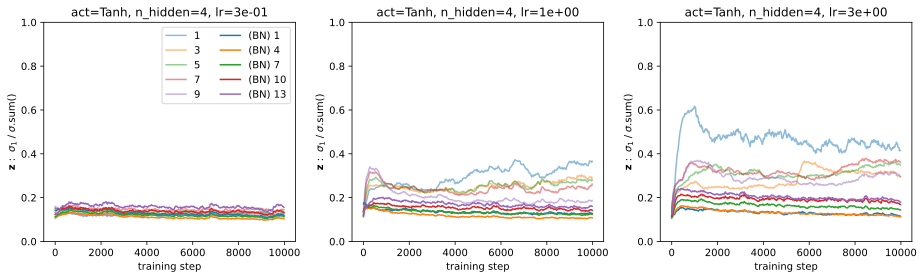

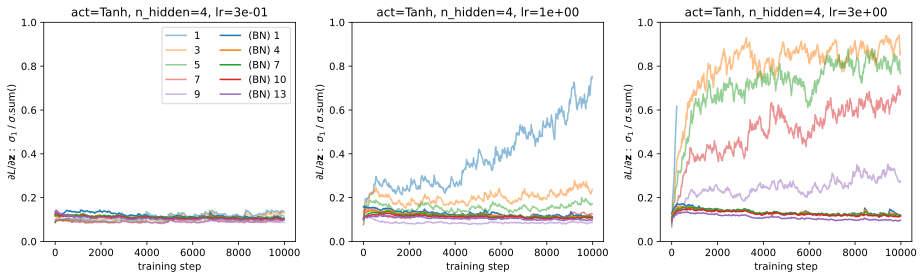

In [52]:
plot_singular_values('out',      experiments_shallow, [4, 6, 8], title_configs=["act", "lr", "n_hidden"])
plot_singular_values('out.grad', experiments_shallow, [4, 6, 8], title_configs=["act", "lr", "n_hidden"])

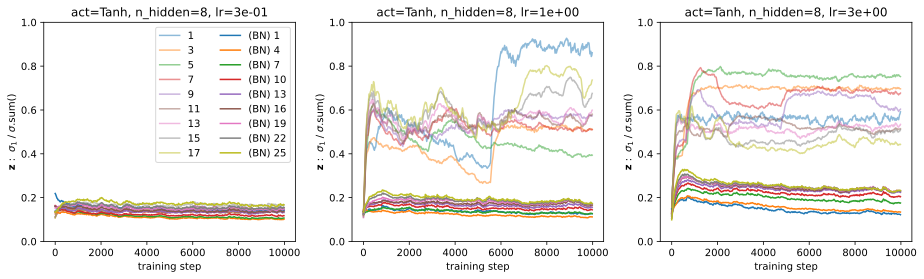

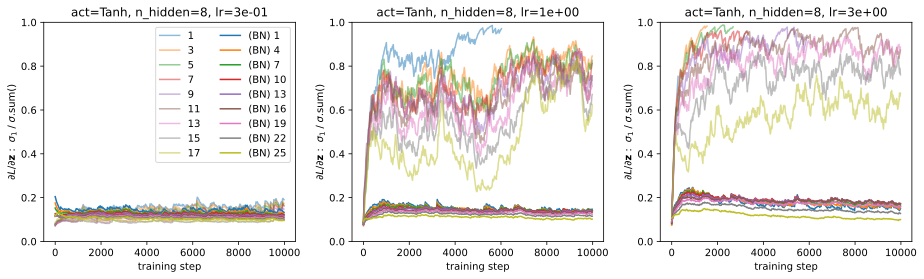

In [53]:
plot_singular_values('out',      experiments_deep, [4, 6, 8], title_configs=["act", "lr", "n_hidden"])
plot_singular_values('out.grad', experiments_deep, [4, 6, 8], title_configs=["act", "lr", "n_hidden"])

Next we show that the growth of preactivation gradients are controlled with BatchNorm:

In [54]:
def plot_grad_magnitude(experiments, indices, title_configs, ylim=None, figsize=(13, 4)):

    no_idx = lambda i: 2*i + 1
    bn_idx = lambda i: 3*i + 1

    fig, ax = plt.subplots(1, len(indices), figsize=figsize)
    for _, k in enumerate(indices):
        e = experiments[k]
        d = experiments[k+1]

        ax[_].set_title(filter_name(e.name, title_configs))
        ax[_].set_ylabel(r'‖∂L/∂$\mathbf{z}$‖₂')
        ax[_].set_xlabel(r'training step')

        for j in range(e.config.n_hidden + 1):
            l = e.hist['gradient_magnitude'][f'Linear.{no_idx(j)}']
            xn, yn = zip(*l)
            yn = ema_inf(yn)
            ax[_].set_ylim(0, max(yn) * 1.1)
            ax[_].plot(xn, yn, color=f"C{j}", alpha=0.5, label=no_idx(j))

        for j in range(e.config.n_hidden + 1):
            h = d.hist['gradient_magnitude'][f'Linear.{bn_idx(j)}']
            xb, yb = zip(*h)
            yb = ema_inf(yb)
            ax[_].plot(xb, yb, color=f"C{j}", label=f"(BN) {bn_idx(j)}")

        if ylim:
            ax[_].set_ylim(*ylim)

    ax[0].legend(ncols=2)
    fig.tight_layout();

In [55]:
plot_grad_magnitude(experiments_shallow, [4, 6, 8], title_configs=["act", "lr", "n_hidden"], ylim=(0, 0.02))
plot_grad_magnitude(experiments_deep,    [4, 6, 8], title_configs=["act", "lr", "n_hidden"], ylim=(0, 0.02))

**Figure.** BN stabilizes the growth of preactivation gradients. As a consequence, magnitude of weights are also stable. As discussed above, this can explain our previous results on the stability of [weight update ratios](03-update-ratio-over-time) for batch normalized networks.

(03-batchnorm:appendix-activations)=
## Appendix: Activations

Activation functions are a crucial part of deep learning models as they add nonlinearity to neural networks. There is a large variety of activation functions in the literature, some more beneficial than others. In this section, we repeat the previous experiments for various activation functions. We will look at distributions of activations and gradients, and the effects of BatchNorm on these distributions.

In [56]:
class ReLU:
    def __call__(self, x, training=False):
        self.out = torch.relu(x)
        return self.out

    def parameters(self):
        return []

class ELU:
    def __call__(self, x, training=False):
        self.out = F.elu(x)
        return self.out

    def parameters(self):
        return []

class LReLU:
    def __call__(self, x, training=False):
        self.out = F.leaky_relu(x, 0.1)
        return self.out

    def parameters(self):
        return []

class Mish:
    def __call__(self, x, training=False):
        self.out = F.mish(x)
        return self.out

    def parameters(self):
        return []

class GELU:
    def __call__(self, x, training=False):
        self.out = F.gelu(x)
        return self.out

    def parameters(self):
        return []

For gains of other functions, we use the gain for ReLU. 

In [57]:
# https://pytorch.org/docs/stable/nn.init.html?highlight=gain#torch.nn.init.calculate_gain
# Gain for unsupported activations likely suboptimal
gain = {
    "tanh":         5/3,
    "relu":         math.sqrt(2),
    "leaky_relu":   math.sqrt(2 / (1 + 0.1**2)),
    "elu":          math.sqrt(2),
    "mish":         math.sqrt(2),
    "gelu":         math.sqrt(2),
}

# Feel free to add to this list by defining them above.
activations = {
    "tanh":         Tanh,
    "relu":         ReLU,
    "leaky_relu":   LReLU,
    "elu":          ELU,
    "mish":         Mish,
    "gelu":         GELU
}

def d(act, x):
    """Compute derivative of activation with respect to x."""
    f = act()
    y = f(x)
    y.backward(torch.ones_like(x))
    return x.grad

# Region x s.t. |f'(x)| <= 0.1:
saturation_fns = {
    "tanh":         lambda x: x.abs() > 1.8183,
    "relu":         lambda x: x < 0.0,
    "leaky_relu":   lambda x: x < 0.0,
    "elu":          lambda x: x < -2.3025,
    "mish":         lambda x: (x < -2.8273) | ((-1.8324 < x) & (x < -0.8901)),
    "gelu":         lambda x: (x < -1.8611) | ((-1.0775 < x) & (x < -0.5534)),
}

### Plotting activations

Plotting activation functions and their gradients. The saturation functions compute indicator functions for **saturation regions** of the activations which are defined as one-dimensional input regions where the activations have small derivatives (here set to `0.1`):

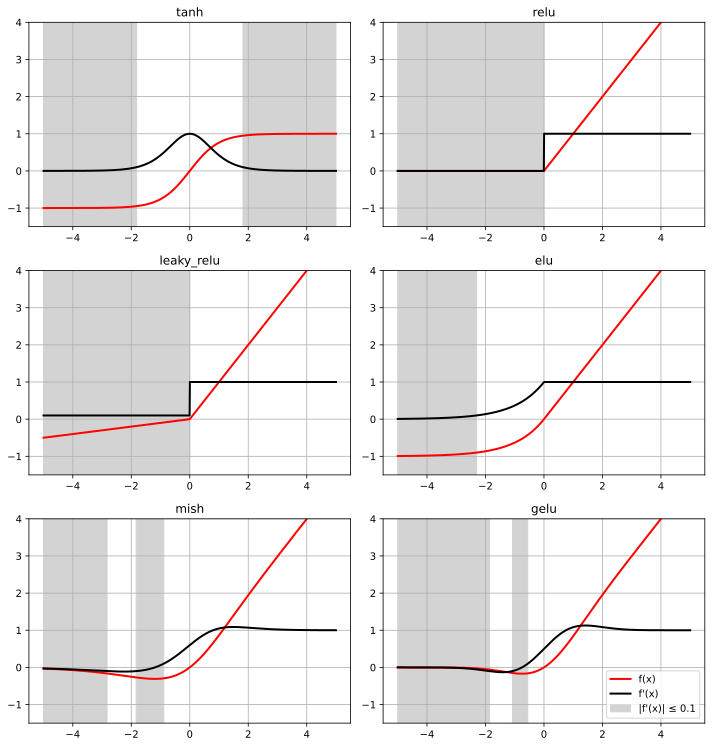

In [58]:
def plot_activation(act: str, ax, x):
    x.grad = None
    f = activations[act]
    y = f()(x)
    df = d(f, x)
    x, y = x.detach().numpy(), y.detach().numpy()
    
    # Plotting
    ax.plot(x, y,  linewidth=2, color='red',   label="f(x)")
    ax.plot(x, df, linewidth=2, color='black', label="f'(x)")
    ax.set_title(act)
    ax.grid()
    ax.set_ylim(-1.5, 4)
    if act == "tanh":
        ax.axvspan(-5, -1.8183, -10, 10, color='lightgray')
        ax.axvspan(1.8183, 5,   -10, 10, color='lightgray')
    elif act == "relu":
        ax.axvspan(-5, 0, -10, 10, color='lightgray')
    elif act == "leaky_relu":
        ax.axvspan(-5, 0, -10, 10, color='lightgray')
    elif act == "elu":
        ax.axvspan(-5, -2.3025, -10, 10, color='lightgray')
    elif act == "mish":
        ax.axvspan(-5,      -2.8273, -10, 10, color='lightgray')
        ax.axvspan(-1.8324, -0.8901, -10, 10, color='lightgray')
    elif act == "gelu":
        ax.axvspan(-5,      -1.8611, -10, 10, color='lightgray')
        ax.axvspan(-1.0775, -0.5534, -10, 10, color='lightgray', label="|f'(x)| ≤ 0.1")
        ax.legend(loc='lower right')


# Plotting
rows = math.ceil(len(activations) / 2.0)
fig, ax = plt.subplots(rows, 2, figsize=(10, rows*3.5))

x = torch.linspace(-5, 5, 1000, requires_grad=True)
for i, act_name in enumerate(activations.keys()):
    plot_activation(act_name, ax[divmod(i, 2)], x)  # divmod(m, n) = m // n, m % n

fig.tight_layout()

**Figure.** Plotting activations and activation gradients. Saturation regions where derivatives are small are highlighted as gray. ReLU {cite}`kaiming` saturates with zero gradient on negative activations. This behavior is modified by LeakyReLU {cite}`leakyrelu` which has a small nonzero gradient in this region. ELU {cite}`elu`, on the other hand, looks like a smoother ReLU but has an activation of -1 on negative inputs. Mish {cite}`mish` is nonmonotonic and has input regions with gradients greater than 1 or less than 0. This property can be helpful in getting more expressive gradients. GELU {cite}`gelu` has similar properties but with a more pronounced shape in the regions.

In [59]:
from itertools import product

# Feel free to extend the configs
experiments_act = []
for act, lr, bn in tqdm(list(product(activations.keys(), [0.1, 0.3, 1.0], [False, True]))):
    config = ExperimentConfig(
        gain=gain[act],
        activation=activations[act],
        batch_norm=bn,
        monitors=monitors,
        lr=lr,
        n_hidden=4,
        n_steps=5000
    )

    e = Experiment(config)
    e.run(verbose=False)
    experiments_act.append(e)

  0%|          | 0/36 [00:00<?, ?it/s]

** On entry to SLASCL, parameter number  4 had an illegal value
** On entry to SLASCL, parameter number  4 had an illegal value
** On entry to SLASCL, parameter number  5 had an illegal value
** On entry to SLASCL, parameter number  4 had an illegal value
** On entry to SLASCL, parameter number  4 had an illegal value
** On entry to SLASCL, parameter number  5 had an illegal value
** On entry to SLASCL, parameter number  4 had an illegal value
** On entry to SLASCL, parameter number  4 had an illegal value
** On entry to SLASCL, parameter number  5 had an illegal value
** On entry to SLASCL, parameter number  4 had an illegal value
** On entry to SLASCL, parameter number  4 had an illegal value
** On entry to SLASCL, parameter number  5 had an illegal value
** On entry to SLASCL, parameter number  4 had an illegal value
** On entry to SLASCL, parameter number  4 had an illegal value
** On entry to SLASCL, parameter number  5 had an illegal value
** On entry to SLASCL, parameter number 

Dictionary of activations whose unnormalized network converged with the given learning rate:

In [60]:
converged = {lr: [] for lr in [0.1, 0.3, 1.0]}
for lr in converged.keys():
    for act in activations.keys():
        exps = [e for e in experiments_act if e.config.lr == lr and e.config.gain == gain[act] and e.config.activation == activations[act]]
        v = list(exps[0].hist['train'].values())[-1]
        if math.isnan(v) or math.isinf(v):
            continue
        else:
            converged[lr].append(act)

converged

{0.1: ['tanh', 'relu', 'leaky_relu', 'elu', 'mish', 'gelu'],
 0.3: ['tanh', 'relu', 'leaky_relu', 'mish', 'gelu'],
 1.0: ['tanh', 'relu', 'mish', 'gelu']}

### Histograms

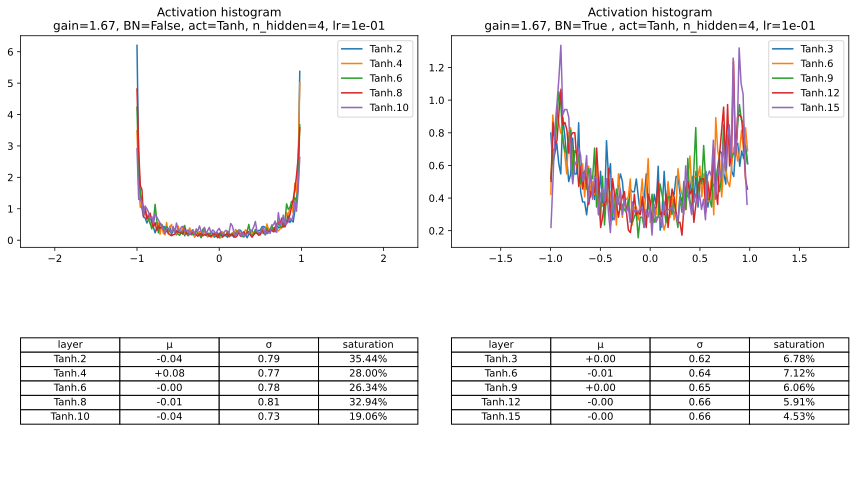

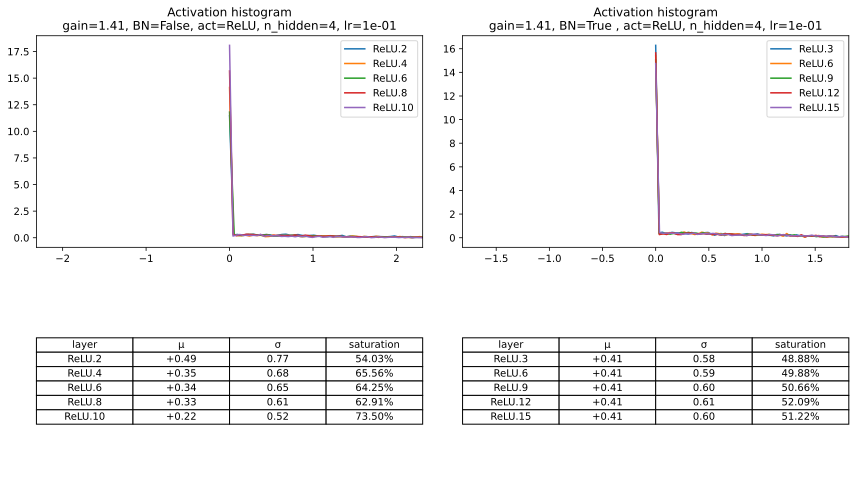

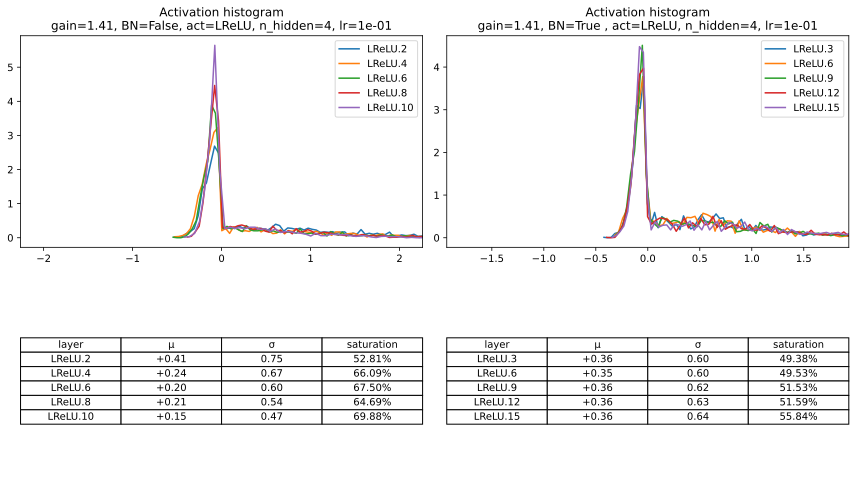

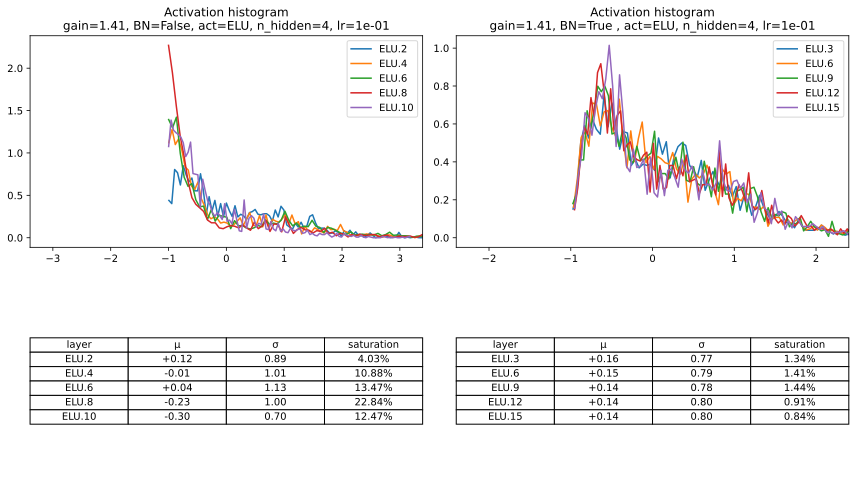

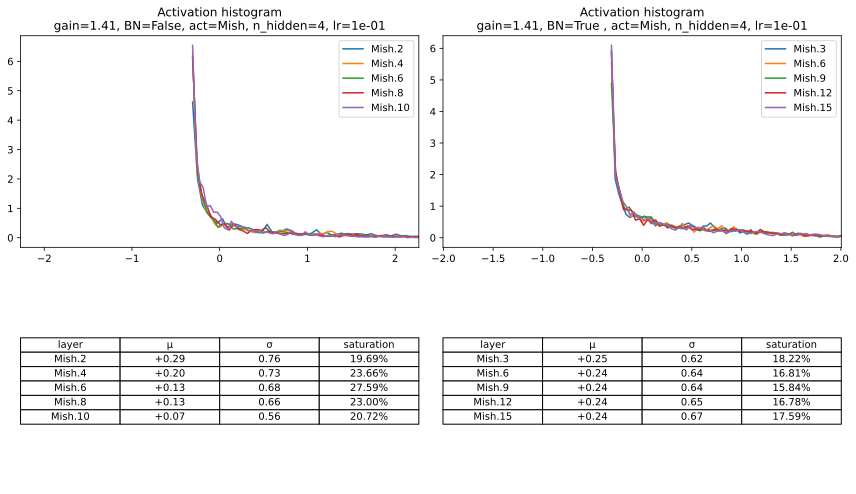

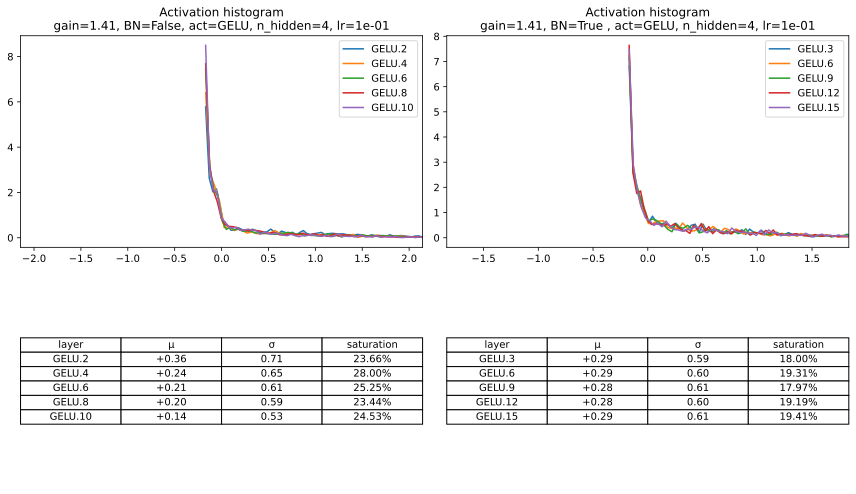

In [61]:
LR = 0.1
for act in converged[LR]:
    plot_activation_histograms(
        [e for e in experiments_act if e.config.lr == LR and e.config.gain == gain[act] and e.config.activation == activations[act]], 
        saturation_fn=saturation_fns[act],
        title_configs=["act", "gain", "BN", "lr", "n_hidden"]
    )

**Figure.** Activation distributions at 5000 SGD steps. BatchNorm results in more controlled saturation and similarly shaped distributions with depth.

### Loss curves

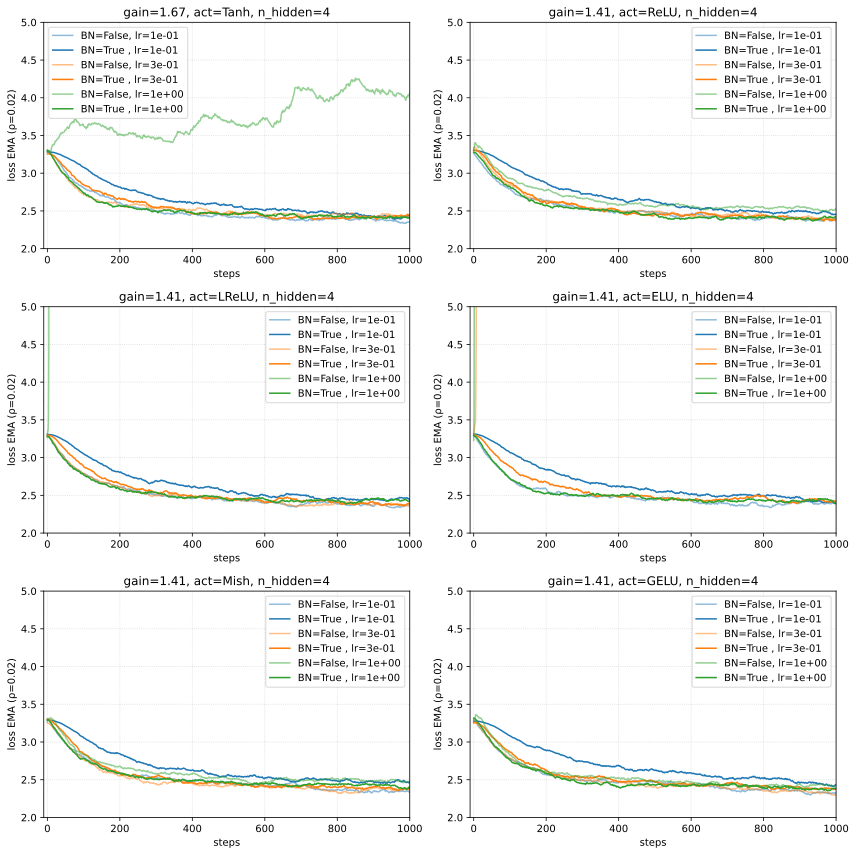

In [62]:
plt.figure(figsize=(12, 12))
for _, act in enumerate(activations.keys()):
    plt.subplot(int("32"+f"{_+1}"))
    plot_loss_curves([e for e in experiments_act if e.config.activation == activations[act]], momentum=0.02, label_configs=['BN', 'lr'], title_configs=['act', 'gain', 'n_hidden'])
    plt.ylim(2, 5)
    plt.xlim(-10, 1000)

**Figure.** Some activations allow for higher learning rates even without BatchNorm. But we can see in the figure below that using BatchNorm allows higher learning rates for all activations. This shows the benefit of BatchNorm at initialization. Note that unnormalized GELU trains even with a large learning rate.

### Update ratio over time

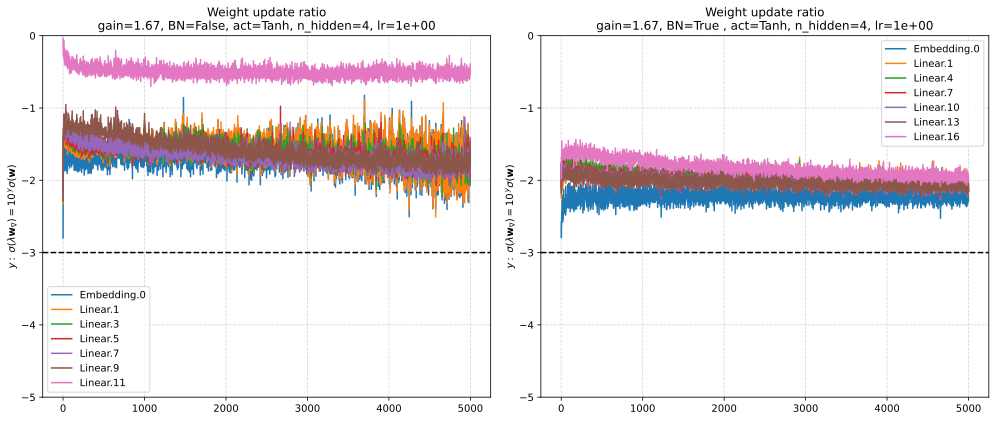

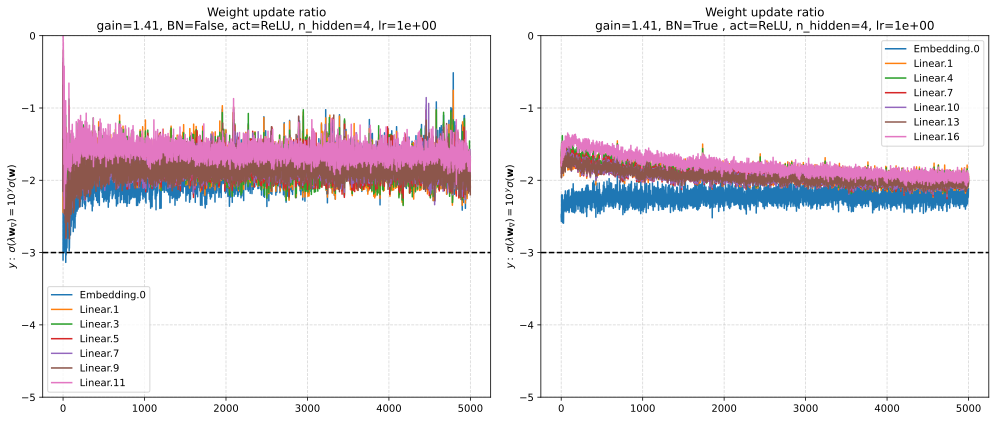

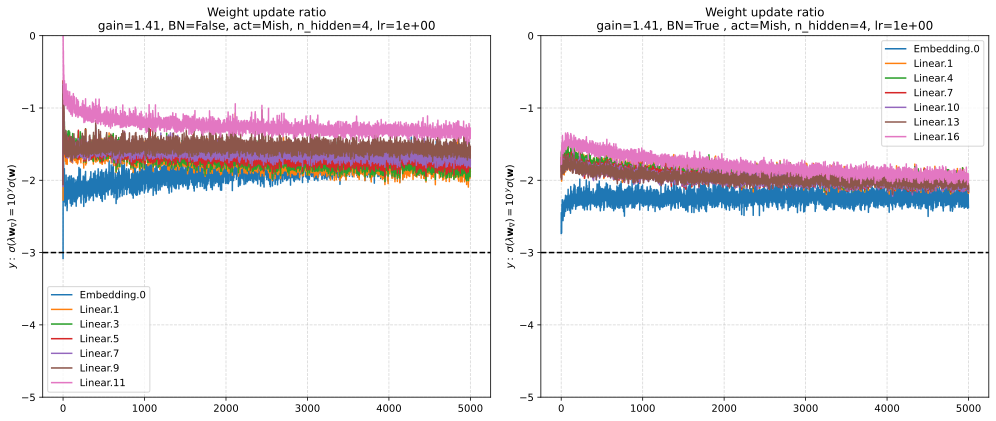

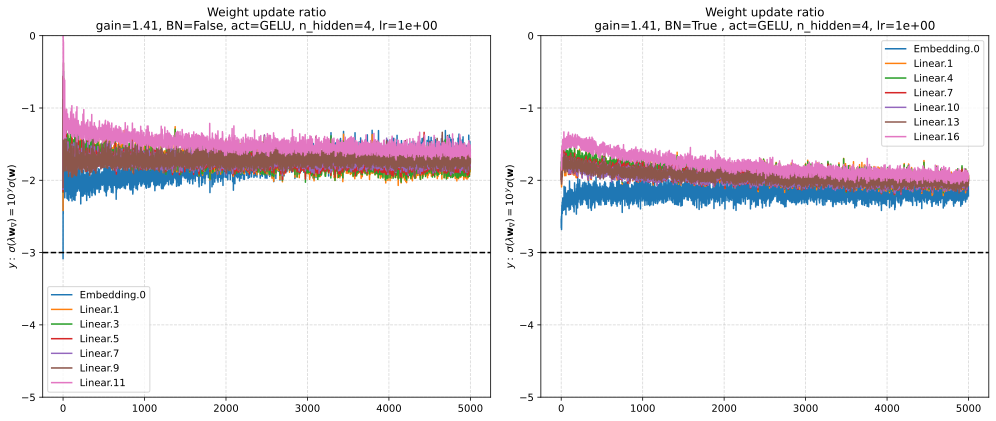

In [63]:
LR = 1.0
for act in converged[LR]:
    exps = [e for e in experiments_act if e.config.lr == LR and e.config.activation == activations[act]]
    plot_update_ratios(exps, ["act", "gain", "BN", "lr", "n_hidden"])

**Figure.** Training with a learning rate of 1. Notice that GELU behaves very similar to its normalized counterpart. Other activations (not shown) diverge at this learning rate (their weight update ratio curves quickly increase to zero). Using BatchNorm results to converging update ratio curves for all activations.

### Rank collapse

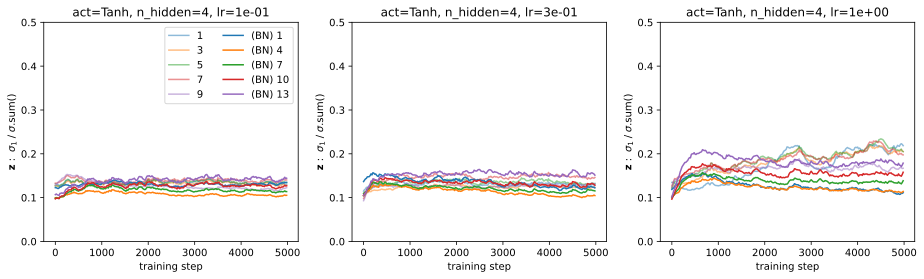

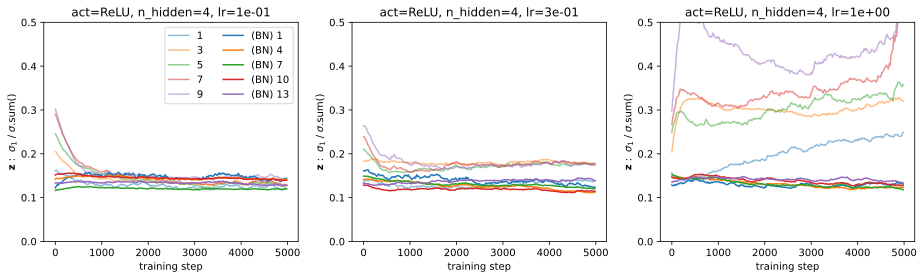

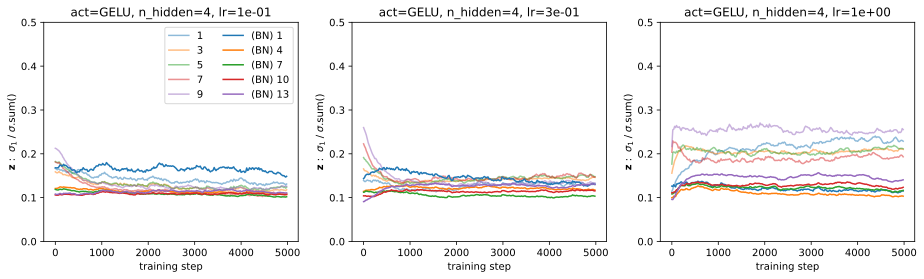

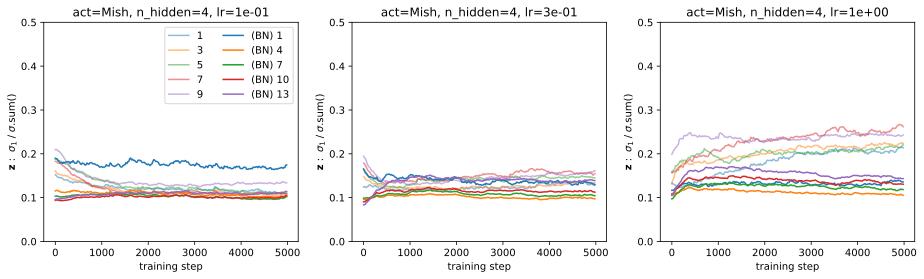

In [64]:
for act in set(converged[0.1]) & set(converged[0.3]) & set(converged[1]):
    exps = list(filter(lambda e: e.config.activation == activations[act], experiments_act))
    plot_singular_values('out', exps, [0, 2, 4], title_configs=["act", "lr", "n_hidden"], ylim=(0, 0.5))

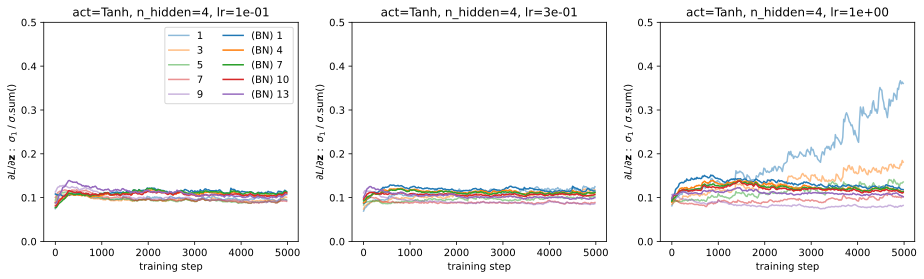

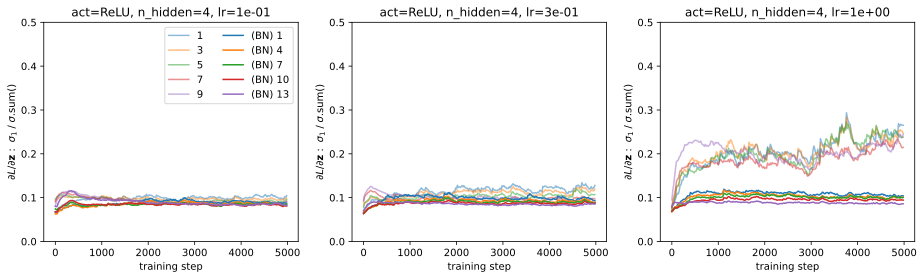

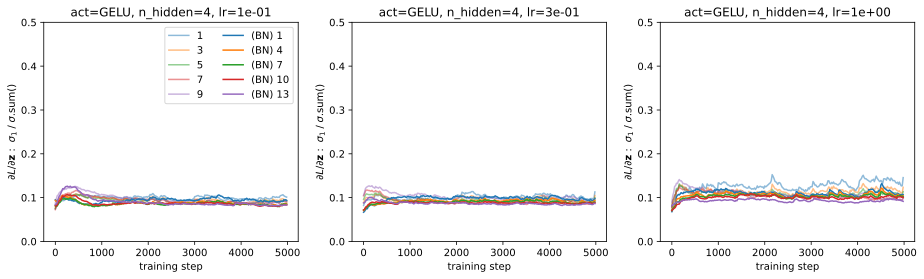

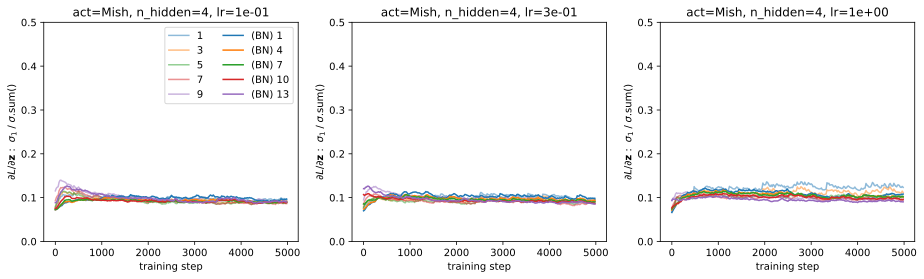

In [65]:
for act in set(converged[0.1]) & set(converged[0.3]) & set(converged[1]):
    exps = list(filter(lambda e: e.config.activation == activations[act], experiments_act))
    plot_singular_values('out.grad', exps, [0, 2, 4], title_configs=["act", "lr", "n_hidden"], ylim=(0, 0.5))

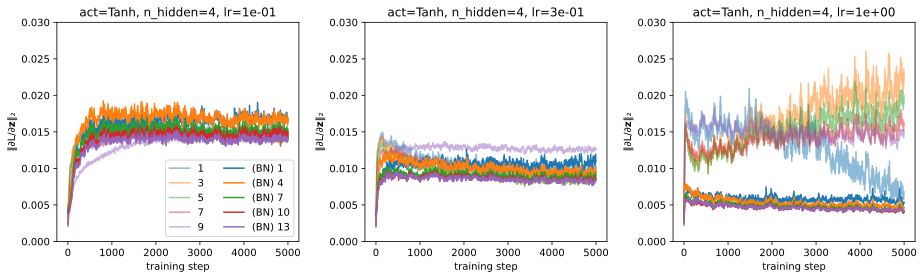

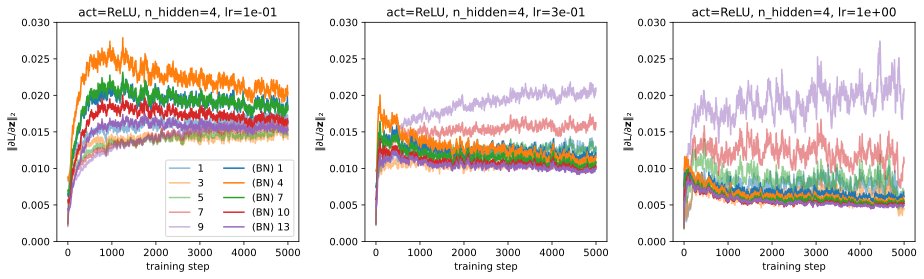

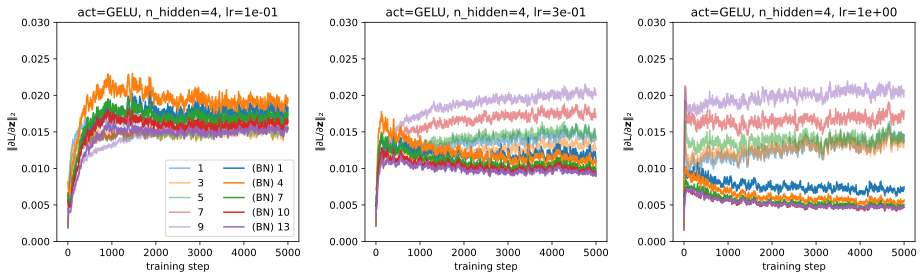

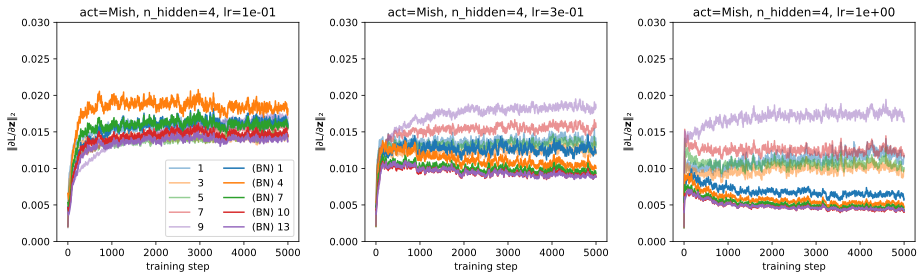

In [66]:
for act in set(converged[0.1]) & set(converged[0.3]) & set(converged[1]):
    exps = list(filter(lambda e: e.config.activation == activations[act], experiments_act))
    plot_grad_magnitude(exps, [0, 2, 4], title_configs=["act", "lr", "n_hidden"], ylim=(0, 0.03))

**Figure.** GELU have more stable preactivation gradients than Tanh. BatchNorm helps in all cases.

## Appendix: Practical details

### Folding 

Recall that we constructed our networks in `create_bn_model` using `[Linear(bias=False), BatchNorm1d, Tanh]` blocks. This allows us to write the Linear and BatchNorm operation in batch-indexed, vectorized form as follows where the multiplication operation $\odot$ broadcasts the row vector $\frac{\boldsymbol{\gamma}}{\sqrt{\boldsymbol{\sigma}^2 + \epsilon}}$ to the rows of the linear layer weights $\boldsymbol{\mathsf{w}}.$ Here the statistics are taken over outputs of the linear layer:

$$
\begin{aligned}
{\boldsymbol{\mathsf{y}}}_{b} = \text{BN}(\text{Linear}(\boldsymbol{\mathsf{x}}_{b})) &= \boldsymbol{\gamma}\, \frac{{\boldsymbol{\mathsf{x}}^\top_{b}} \boldsymbol{\mathsf{w}} - \boldsymbol{\mu}}{\sqrt{\boldsymbol{\sigma}^2 + \epsilon}} + \boldsymbol{\beta} \\
&= {\boldsymbol{\mathsf{x}}^\top_{b}} \left( \frac{\boldsymbol{\gamma}}{\sqrt{\boldsymbol{\sigma}^2 + \epsilon}} \odot \boldsymbol{\mathsf{w}} \right) + \left(\boldsymbol{\beta} - \frac{\boldsymbol{\gamma} \boldsymbol{\mu}}{\sqrt{\boldsymbol{\sigma}^2 + \epsilon}}\right)
\end{aligned}
$$

It follows that BatchNorm is essentially a linear operation at inference when the batch statistics are frozen. In this case, the BatchNorm layer is said to be **folded** into the linear layer. Folding all BatchNorm layers prior to deployment results in significantly faster prediction. This is demonstrated below. Note that we set `training=True` to get nontrivial statistics.

In [67]:
model = create_model(activation=Tanh, gain=1.0, batch_norm=True, n_hidden=4)

model(xs, training=True)
print(model.layers[2][1].u_ema.mean().item(), model.layers[2][1].v_ema.mean().item())
model.layers

0.0028906173538416624 1.0061243772506714


[('Embedding.0', <__main__.Embedding at 0x302b704c0>),
 ('Linear.1', <__main__.Linear at 0x302b70d30>),
 ('BatchNorm1d.2', <__main__.BatchNorm1d at 0x30322cb20>),
 ('Tanh.3', <__main__.Tanh at 0x303315e20>),
 ('Linear.4', <__main__.Linear at 0x3032ffcd0>),
 ('BatchNorm1d.5', <__main__.BatchNorm1d at 0x302b522e0>),
 ('Tanh.6', <__main__.Tanh at 0x2b6e1b340>),
 ('Linear.7', <__main__.Linear at 0x2b6e1b280>),
 ('BatchNorm1d.8', <__main__.BatchNorm1d at 0x303513d90>),
 ('Tanh.9', <__main__.Tanh at 0x3035b0c40>),
 ('Linear.10', <__main__.Linear at 0x30325fd30>),
 ('BatchNorm1d.11', <__main__.BatchNorm1d at 0x28f7bc5e0>),
 ('Tanh.12', <__main__.Tanh at 0x302b706d0>),
 ('Linear.13', <__main__.Linear at 0x302b70640>),
 ('BatchNorm1d.14', <__main__.BatchNorm1d at 0x302b70df0>),
 ('Tanh.15', <__main__.Tanh at 0x302b70b80>),
 ('Linear.16', <__main__.Linear at 0x3032ff610>),
 ('BatchNorm1d.17', <__main__.BatchNorm1d at 0x302b70670>)]

Folding BatchNorm into linear layers:

In [68]:
model_folded = create_model(activation=Tanh, gain=1.0, batch_norm=False, n_hidden=4)
model_folded.layers = []

for i, (layer_name, layer) in enumerate(model.layers):

    if isinstance(layer, Linear):
        layer_folded = Linear(*layer.W.shape)
        with torch.no_grad():
            _, bn = model.layers[i+1]
            u = bn.u_ema
            v = bn.v_ema 
            layer_folded.b = bn.beta - bn.gamma * u / torch.sqrt(bn.eps + v)
            layer_folded.W = (bn.gamma / torch.sqrt(bn.eps + v)) * layer.W

    elif isinstance(layer, BatchNorm1d):
        continue
    else:
        layer_folded = layer

    model_folded.layers.append((layer_name, layer_folded))


# Production model to deploy for inference
model_folded.layers

[('Embedding.0', <__main__.Embedding at 0x302b704c0>),
 ('Linear.1', <__main__.Linear at 0x28f48e9a0>),
 ('Tanh.3', <__main__.Tanh at 0x303315e20>),
 ('Linear.4', <__main__.Linear at 0x302b29160>),
 ('Tanh.6', <__main__.Tanh at 0x2b6e1b340>),
 ('Linear.7', <__main__.Linear at 0x302b6e070>),
 ('Tanh.9', <__main__.Tanh at 0x3035b0c40>),
 ('Linear.10', <__main__.Linear at 0x30322c4c0>),
 ('Tanh.12', <__main__.Tanh at 0x302b706d0>),
 ('Linear.13', <__main__.Linear at 0x2b6e7e760>),
 ('Tanh.15', <__main__.Tanh at 0x302b70b80>),
 ('Linear.16', <__main__.Linear at 0x3034f5eb0>)]

In [69]:
print("MAE:", (model(xs) - model_folded(xs)).abs().max().item())

MAE: 9.685754776000977e-08


In [70]:
%timeit model(xs);

664 ms ± 278 ms per loop (mean ± std. dev. of 7 runs, 1 loop each)


In [71]:
%timeit model_folded(xs);

487 ms ± 128 ms per loop (mean ± std. dev. of 7 runs, 1 loop each)


**Remark.** Note that the running statistics can be updated using PreciseBN {cite}`precisebn` before the BatchNorm layers are folded to get better estimates for the deployed model. See this [implementation](https://detectron2.readthedocs.io/en/latest/modules/fvcore.html#fvcore.nn.update_bn_stats) for PyTorch models and data loaders. PreciseBN is further discussed in the next section.

### BatchNorm issues

BatchNorm is a weird layer; its benefits come at a huge cost. For example, it tracks statistics that are learned using EMA instead of gradient descent. It has two modes: **train** and **eval** that can cause bugs when you forget this setting. This becomes apparent in [transfer learning](https://keras.io/guides/transfer_learning/#finetuning) where you have to carefully tune the momentum parameter of BatchNorm layers, or simply call these layers in eval mode even during training in addition to carefully tuning learning rate. Another fundamental difficulty with BatchNorm is that examples in our mini-batches are now coupled. Some of these issues are discussed in this section.

#### Batch coupling 

Although this has a nice regularization effect by adding some noise on the training example as a result of the other examples in the batch, batch coupling turns out to be really bug prone. For example, using BatchNorm requires us to work with **large batch sizes**. Sampling noise increase with lower batch size resulting in worse performance for BatchNorm ({numref}`batchnorm-batchsize`). Our implementation differs from PyTorch and the original paper in that it uses the unbiased variance for both training and inference. In general, we want to avoid BatchNorm as much as possible. There are more recent normalization techniques that have the same benefits as BatchNorm, but do not have this coupling issue {cite}`groupnorm` {cite}`layernorm`.

```{margin}
**Fig 1** in {cite}`groupnorm`
```
```{figure} ../../img/batchnorm-batchsize.png
---
width: 400px
name: batchnorm-batchsize
---
Validation errors vs. batch size of a ResNet-50 model trained in the ImageNet training set.
```

#### PreciseBN

Recall that output statistics of the linear layers are estimated using an exponential moving average for inference with BatchNorm layers. This results in effectively different weights for each sample depending on the momentum parameter. A small momentum parameter results in slower convergence to a stable estimate which is largely dominated by past input features that become outdated as the model weights evolve. On the other hand, a large momentum parameter means that the statistics will be biased towards recent mini-batches that may not be representative. To make the running averages more precise, the BatchNorm stats are recomputed in {cite}`precisebn` with (1) fixed **sample weights** and (2) a fixed **model state**.

```{margin}
**Fig 3** in {cite}`precisebn`
```
```{figure} ../../img/precisebn-1.png
---
width: 450px
name: precisebn-1
---
ResNet-50 training on ImageNet following the recipe in {cite}`imagenet1hour` with
a regular total batch size of 256 distributed on 8 GPUs. Training and validation error curves with EMA (more noisy) and PreciseBN. Note that training error  is not affected by how population statistics is trained, so only one training curve is shown.
```

```{margin}
**Fig 4** in {cite}`precisebn`
```
```{figure} ../../img/precisebn-2.png
---
width: 450px
name: precisebn-2
---
Model training in {numref}`precisebn-1`. Validation curves using different test-time statistics (EMA vs. PreciseBN) and training batch sizes (256 vs. 8192).
```

---

In [75]:
from datetime import datetime

now = datetime.now()
dt_string = now.strftime("%d/%m/%Y %H:%M:%S")
print("Last updated:", dt_string)

Last updated: 29/03/2023 06:00:19
